<a href="https://colab.research.google.com/github/yubinlee98/Thesis/blob/main/Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Packages that are needed to implement this model

In [1]:
!pip install torch torchvision
!pip install pyEDFlib
!pip install mne
!pip install torch transformers pyedflib librosa scikit-learn accelerate
!pip install tensorboard
!pip install pyedflib librosa scikit-learn

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21

Import packages needed

In [5]:
import numpy as np
import pandas as pd
import os
import torch
import mne
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
from torch.optim import AdamW
from torch.optim.lr_scheduler import CosineAnnealingLR
from torch.utils.tensorboard import SummaryWriter
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils import resample
from imblearn.over_sampling import SMOTE
import pyedflib
from scipy.signal import butter, lfilter, iirnotch
import matplotlib.pyplot as plt
import copy
from collections import Counter

In [3]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


Optional cell to run as this cell was to check the raw eeg information structure

Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaapel_s001_t000.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 334749  =      0.000 ...  1338.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>
Using matplotlib as 2D backend.


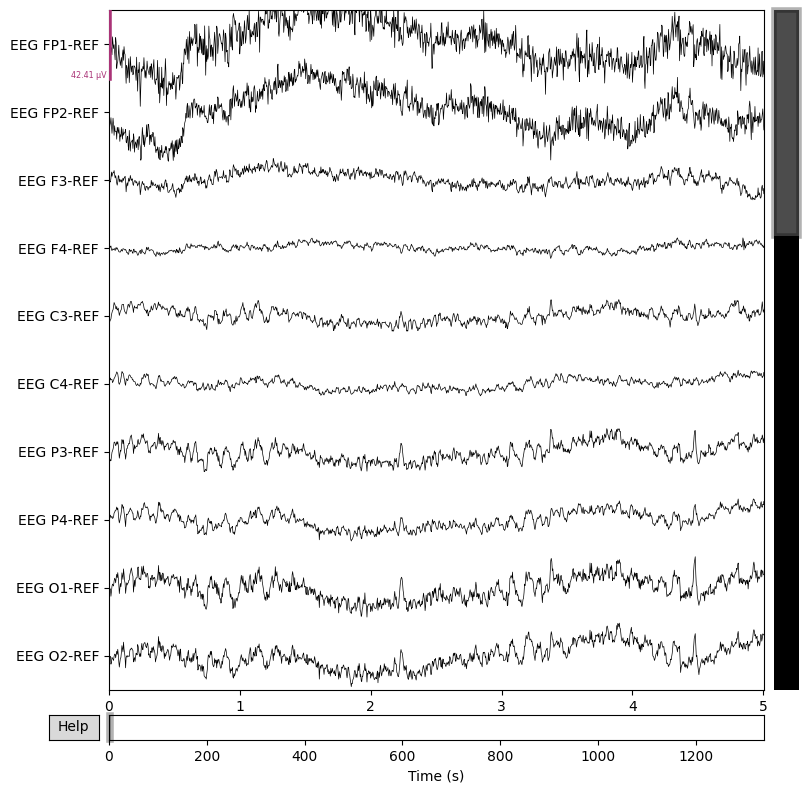

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaankx_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 357499  =      0.000 ...  1429.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


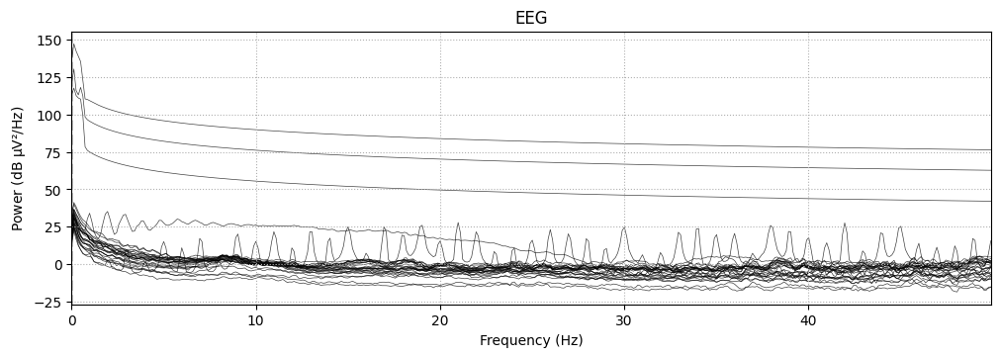

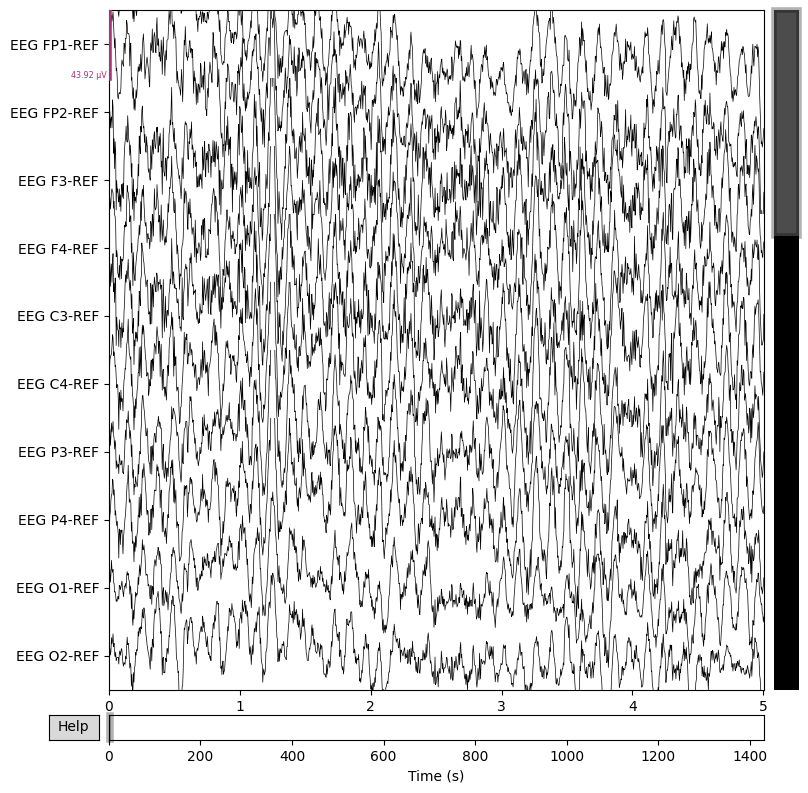

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaamoo_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:16: UserWarning: Zero value in spectrum for channels IBI, BURSTS, SUPPR
  psd = raw.compute_psd(fmax=50)
<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: UserWarning: Infinite value in PSD for channels IBI, BURSTS, SUPPR.
These channels might be dead.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 346249  =      0.000 ...  1384.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


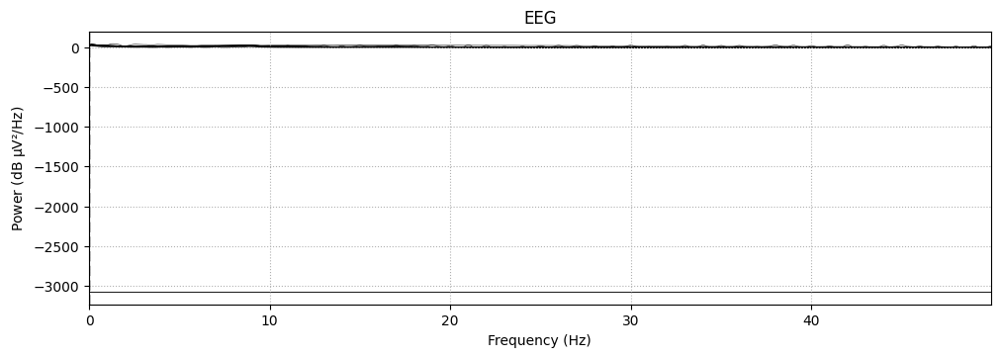

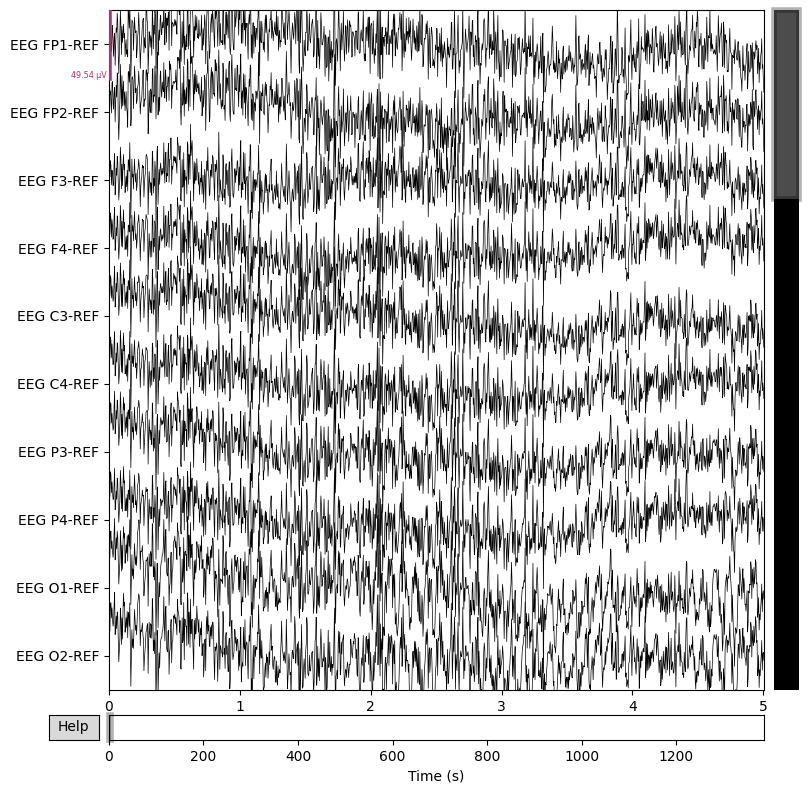

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaajzz_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 330749  =      0.000 ...  1322.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2010-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


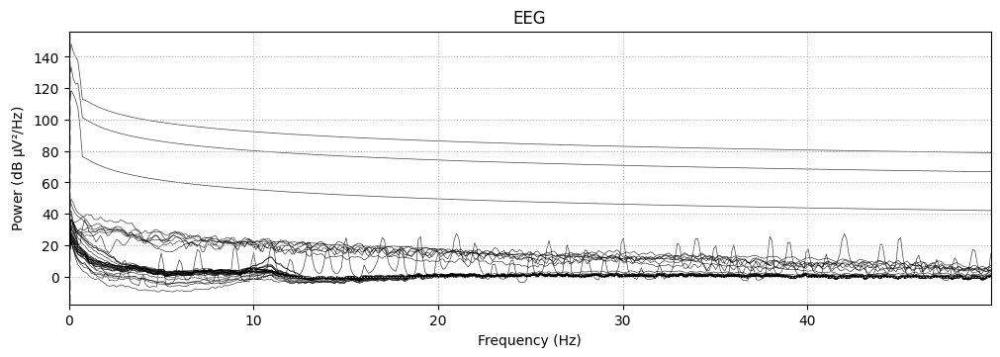

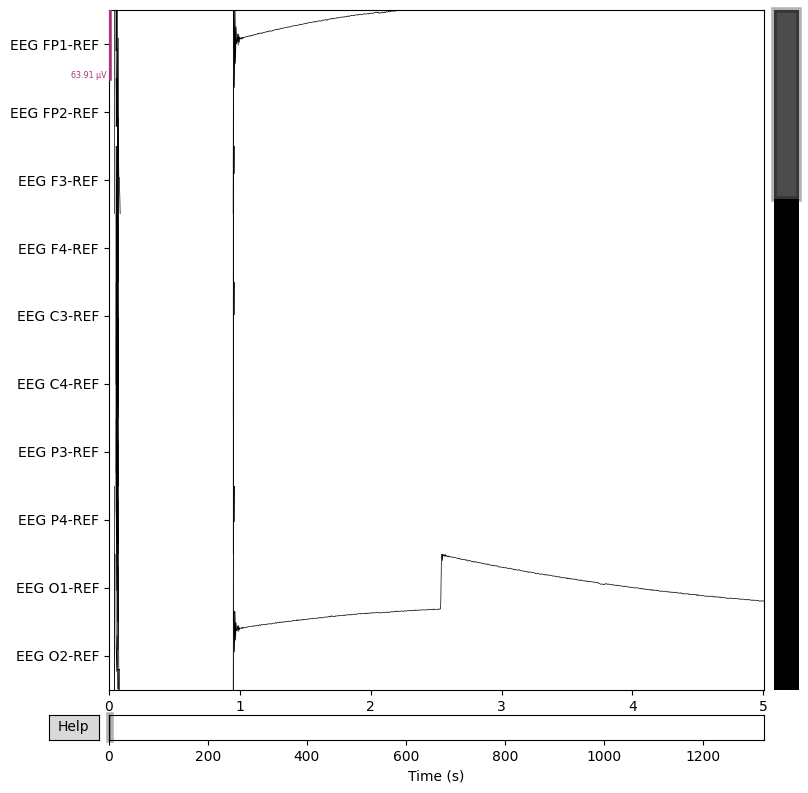

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaapmu_s002_t018.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 1115999  =      0.000 ...  4463.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


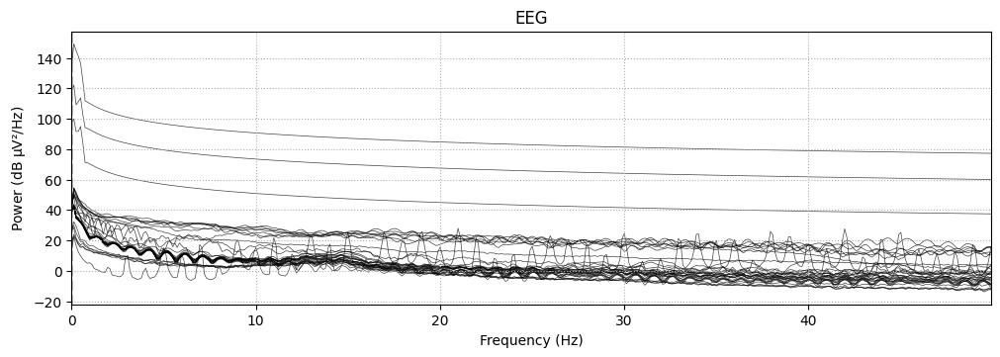

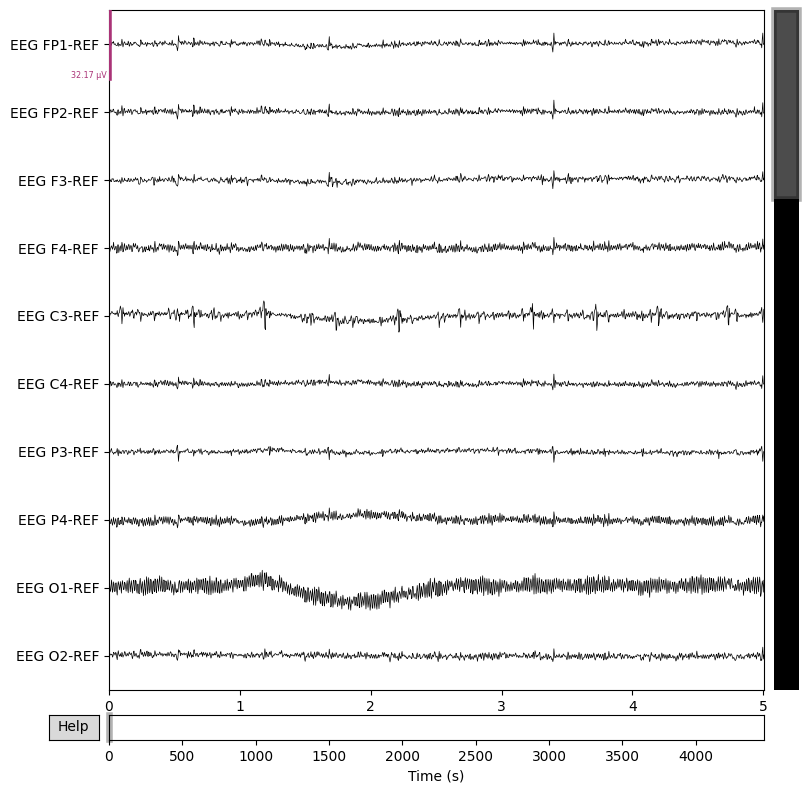

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaamsg_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:16: UserWarning: Zero value in spectrum for channel PHOTIC-REF
  psd = raw.compute_psd(fmax=50)
<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: UserWarning: Infinite value in PSD for channel PHOTIC-REF.
These channels might be dead.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 323749  =      0.000 ...  1294.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


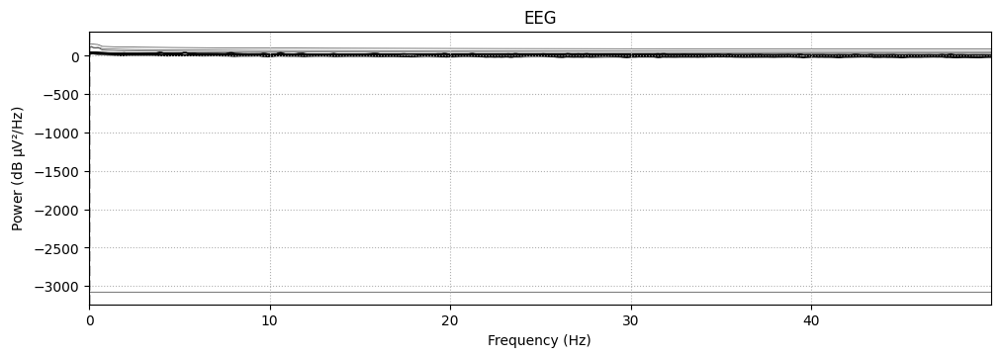

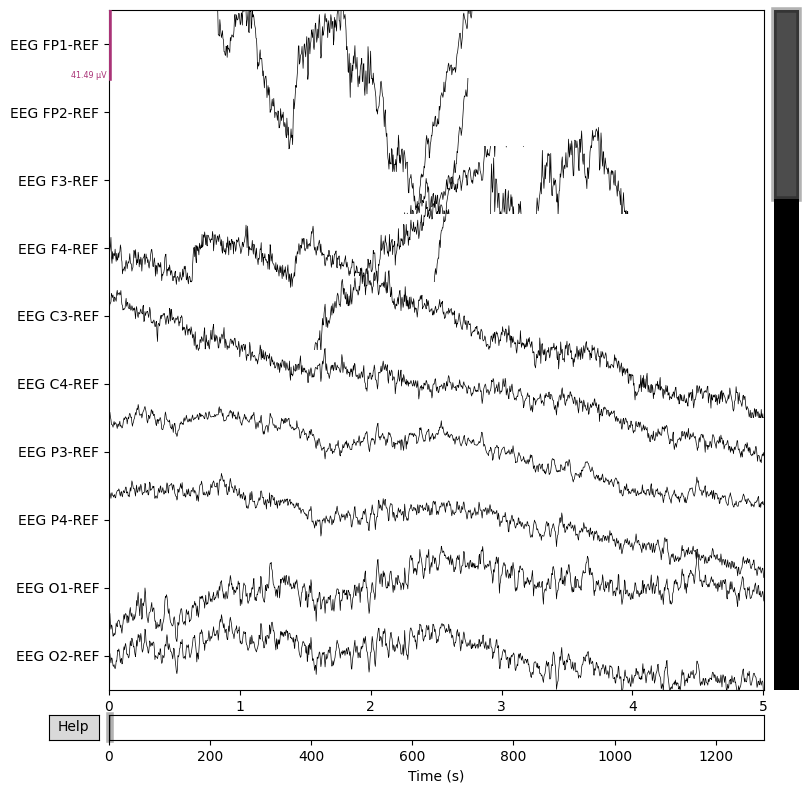

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaabzx_s004_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 366749  =      0.000 ...  1466.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


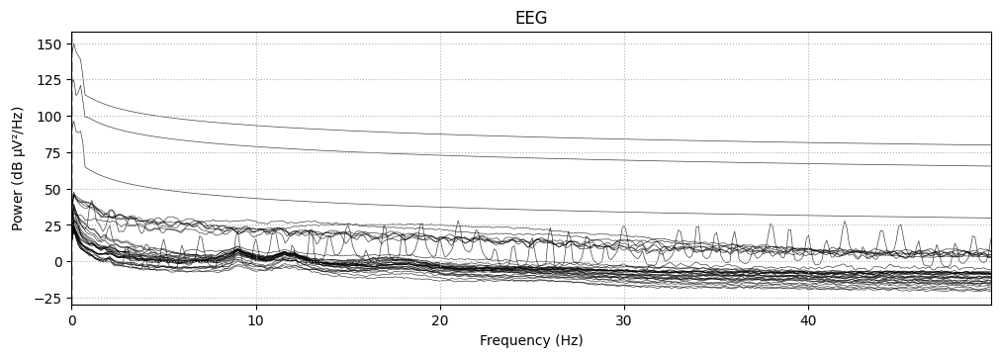

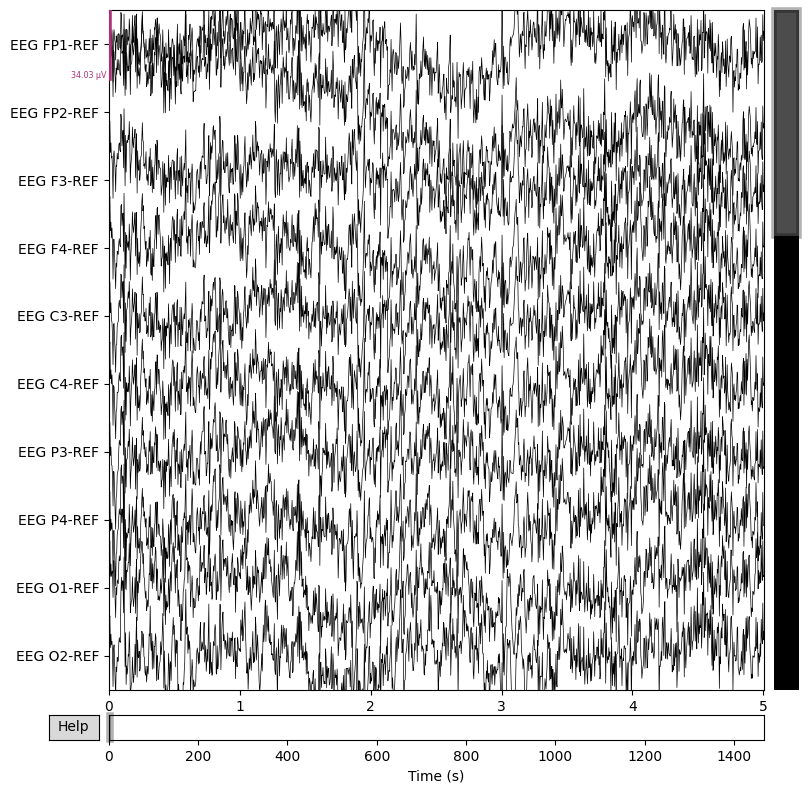

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaanil_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:16: UserWarning: Zero value in spectrum for channels IBI, BURSTS, SUPPR
  psd = raw.compute_psd(fmax=50)
<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: UserWarning: Infinite value in PSD for channels IBI, BURSTS, SUPPR.
These channels might be dead.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 300999  =      0.000 ...  1203.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


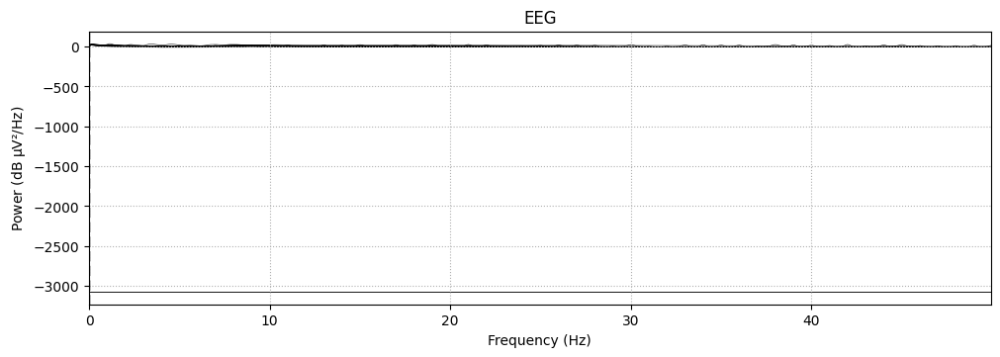

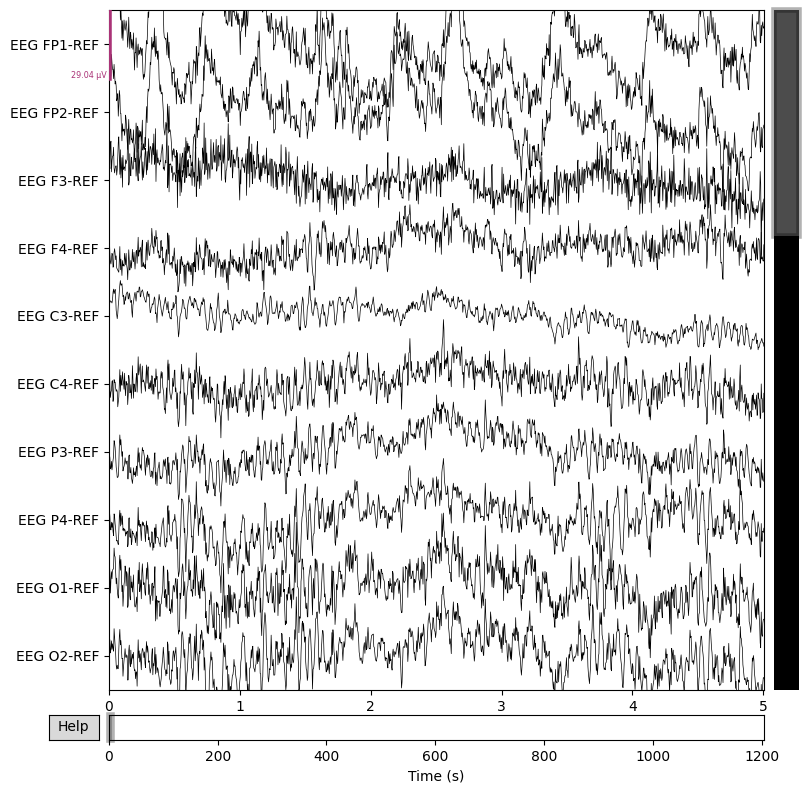

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaowr_s001_t001.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 357749  =      0.000 ...  1430.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


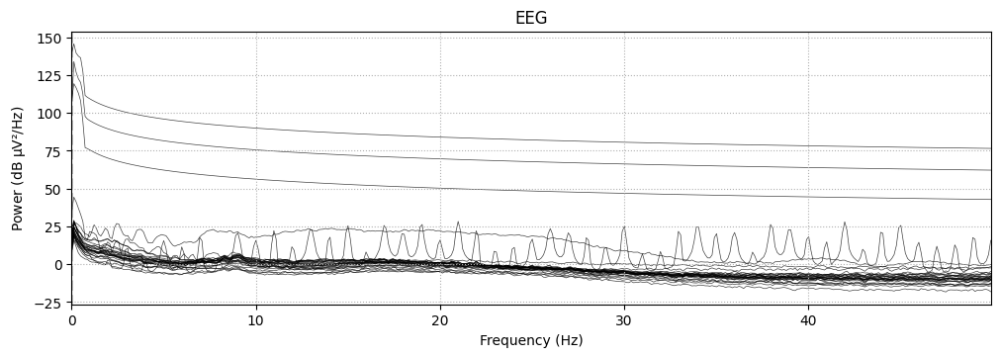

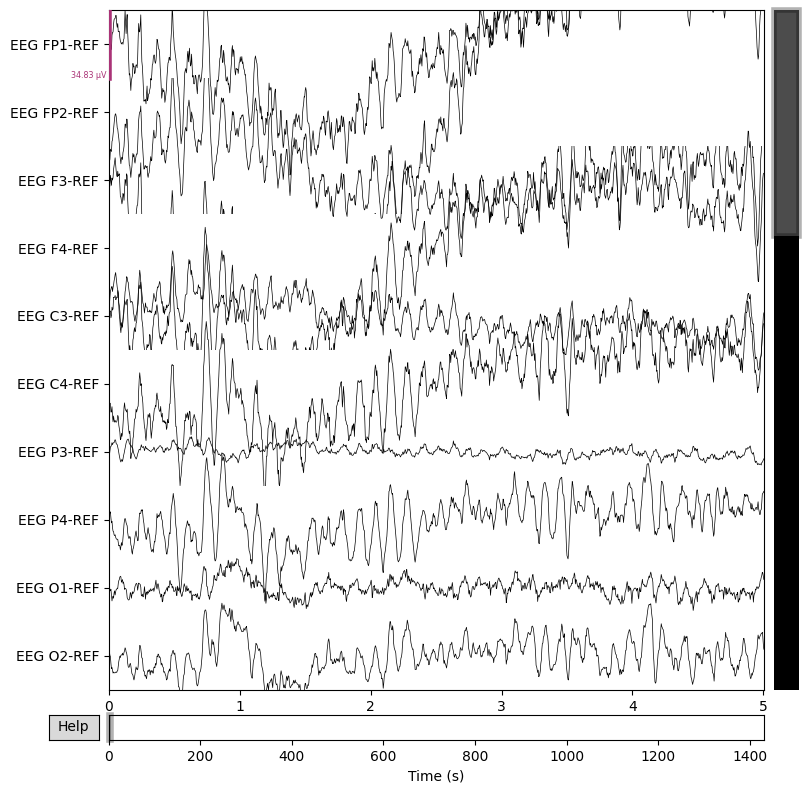

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaotj_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:16: UserWarning: Zero value in spectrum for channels IBI, BURSTS, SUPPR
  psd = raw.compute_psd(fmax=50)
<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: UserWarning: Infinite value in PSD for channels IBI, BURSTS, SUPPR.
These channels might be dead.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 390249  =      0.000 ...  1560.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


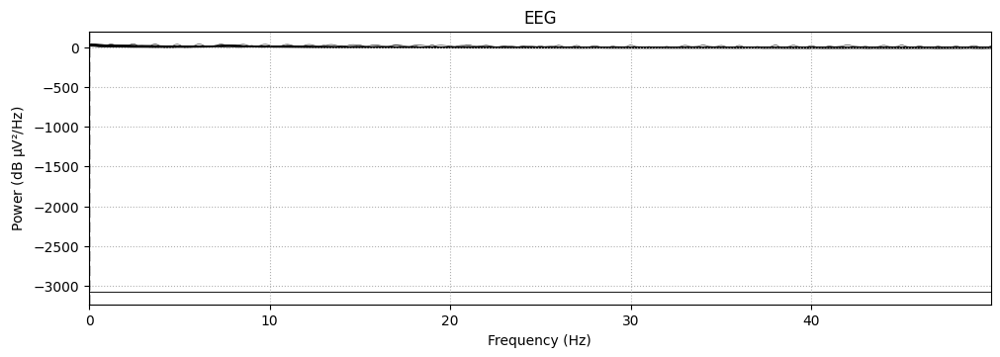

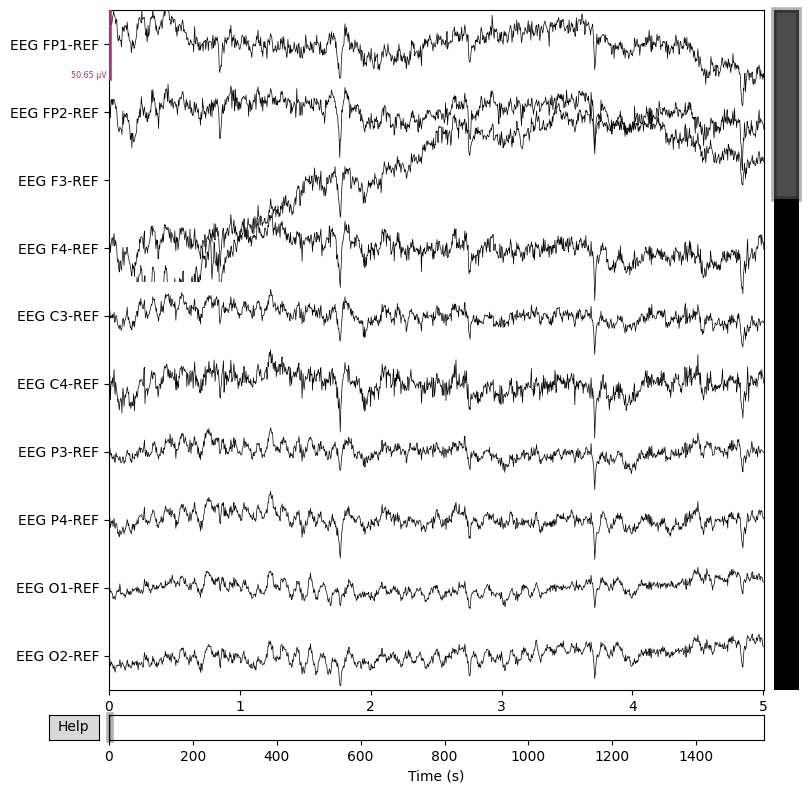

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaabnq_s003_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 316499  =      0.000 ...  1265.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2011-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


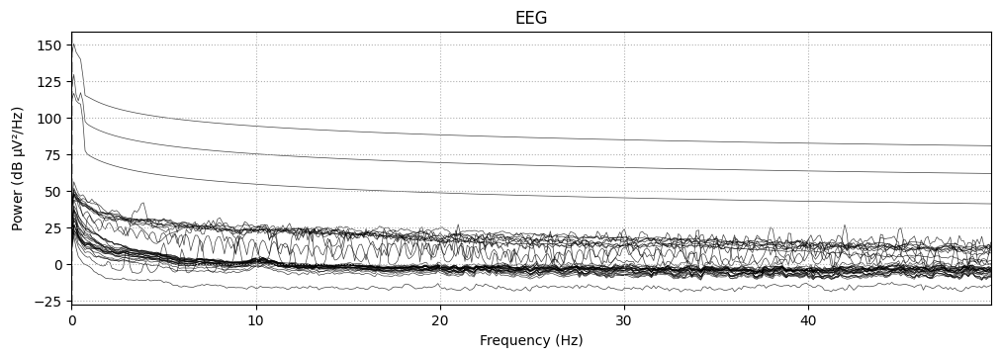

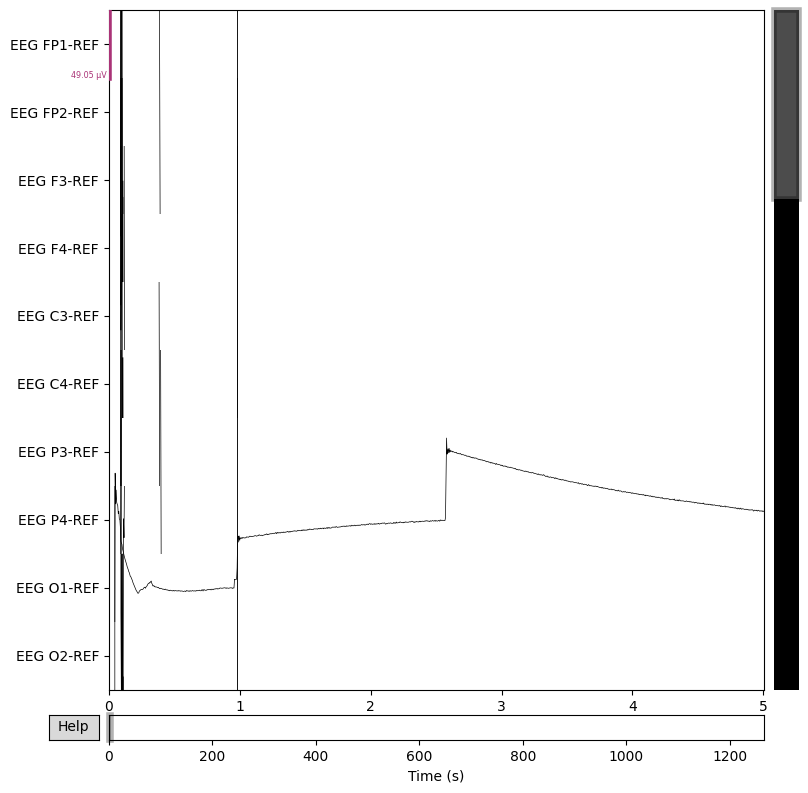

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaofi_s002_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 330749  =      0.000 ...  1322.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


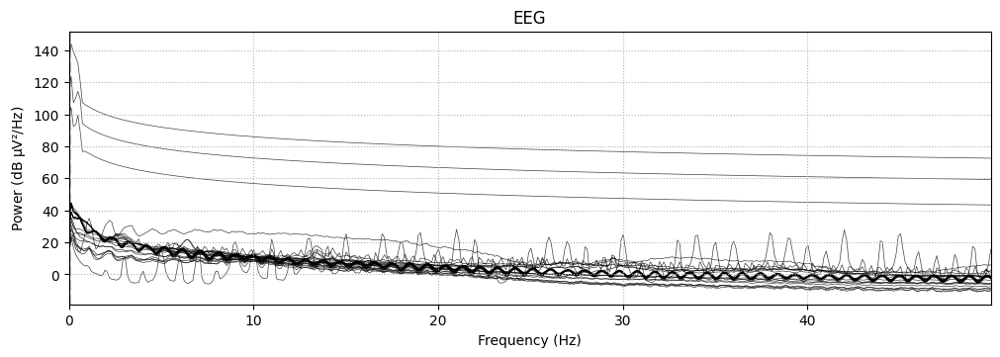

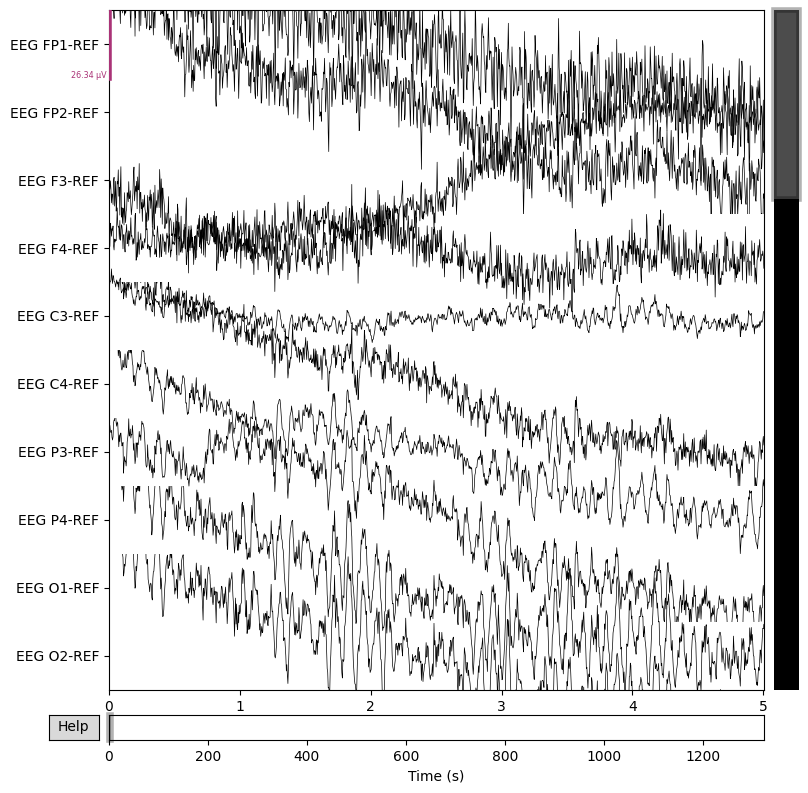

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaakow_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 304499  =      0.000 ...  1217.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2010-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


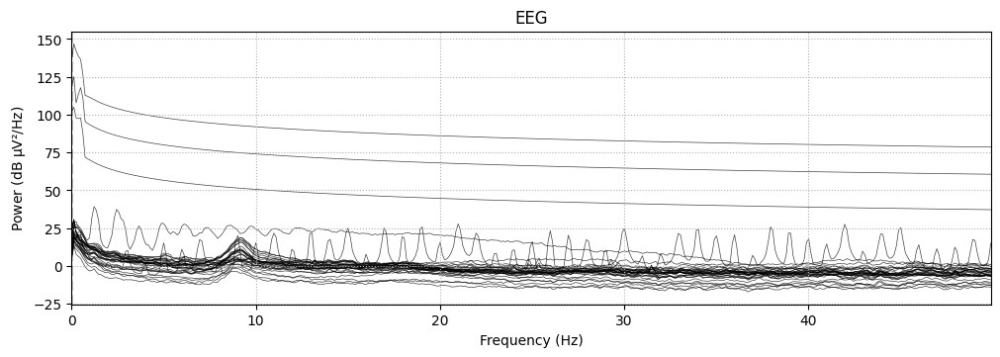

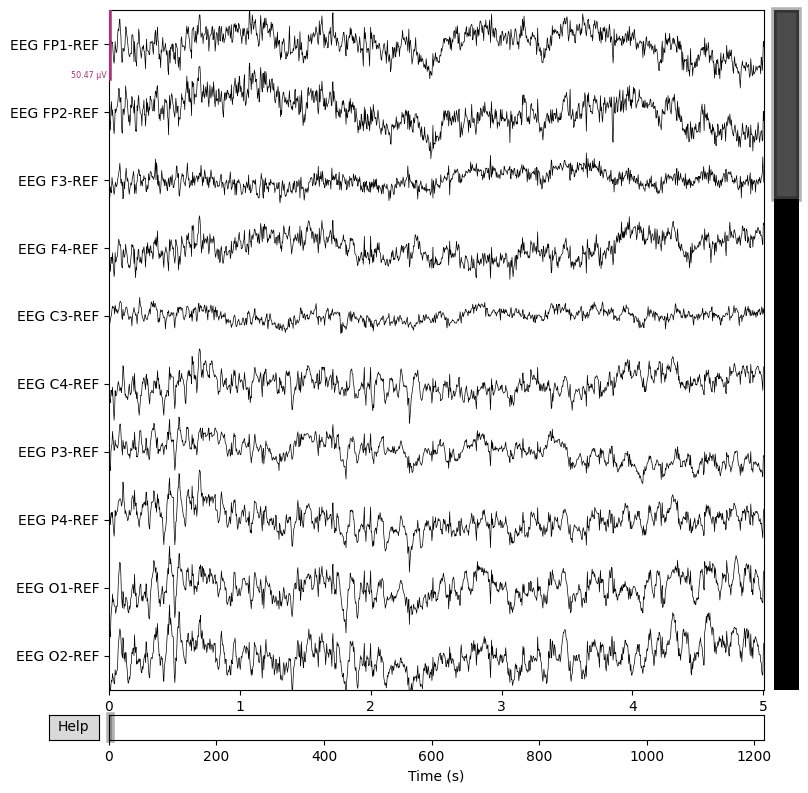

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaalvt_s001_t001.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 294999  =      0.000 ...  1179.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2011-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


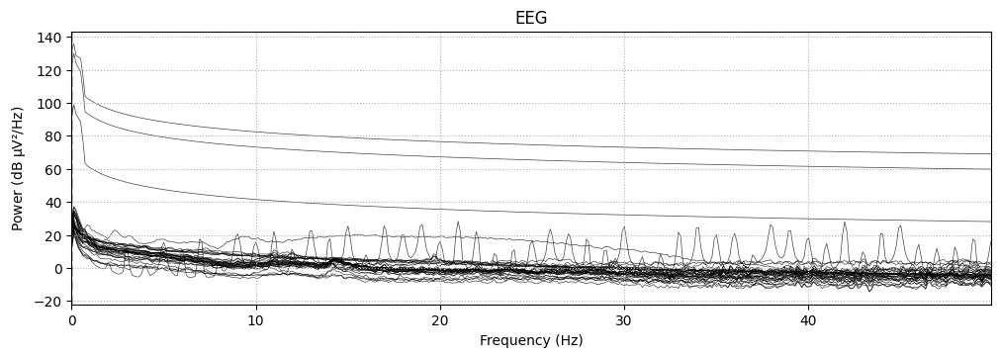

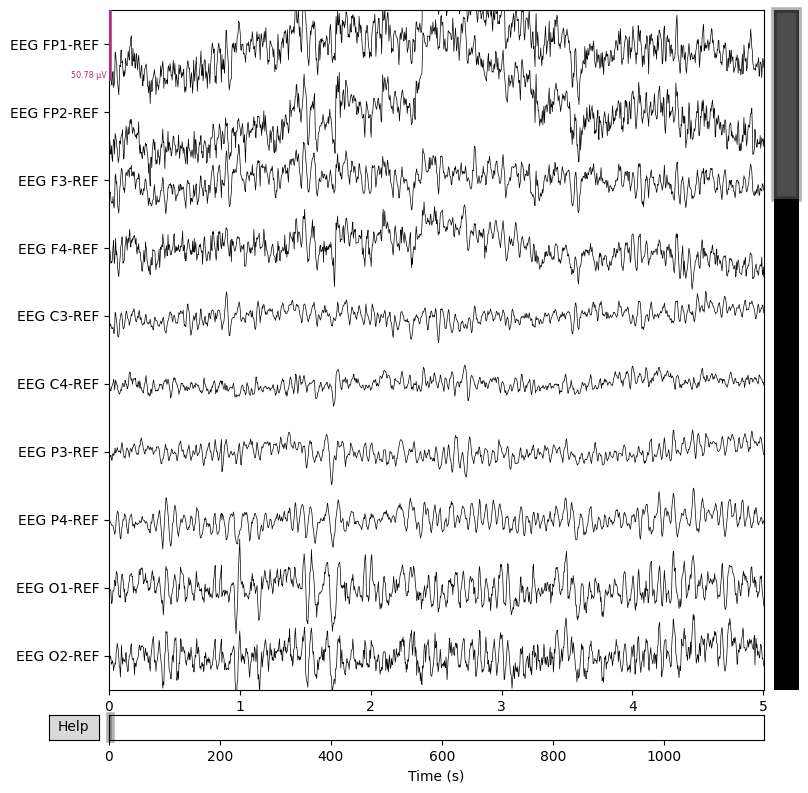

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaajns_s006_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 288999  =      0.000 ...  1155.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2010-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


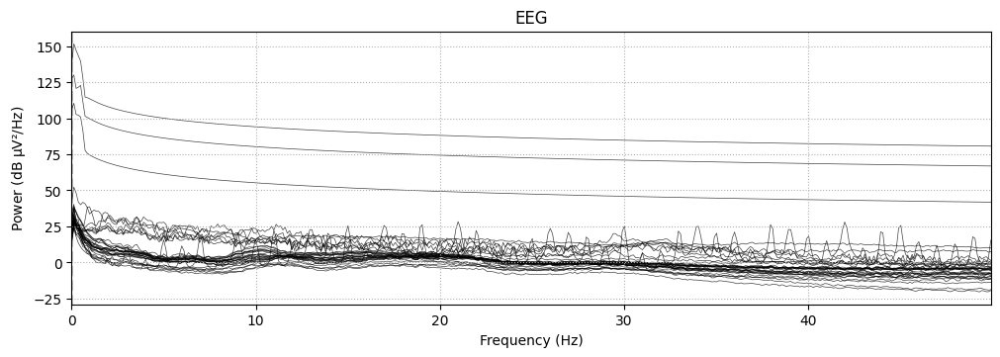

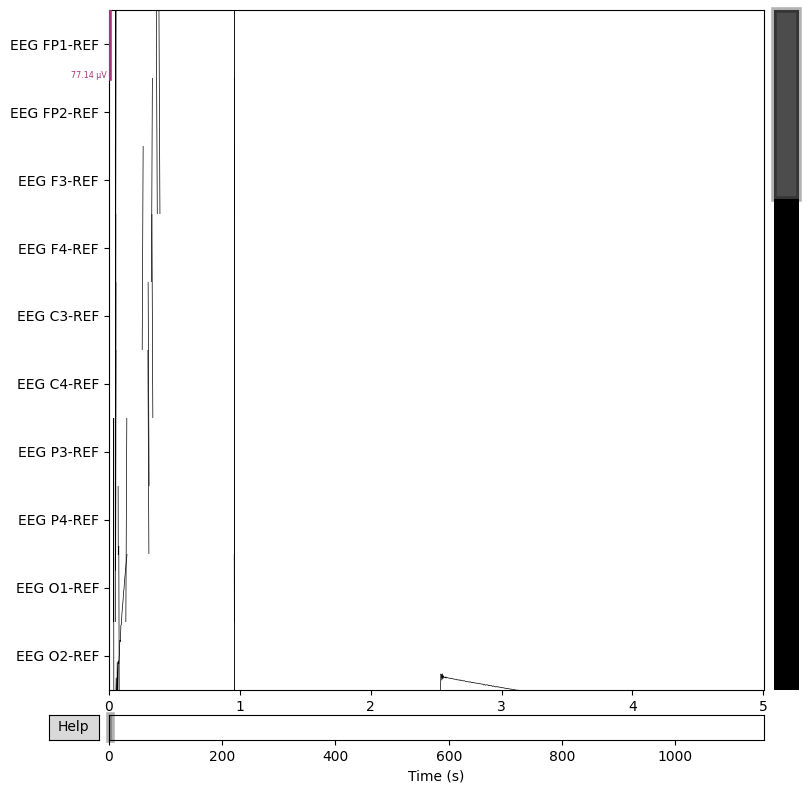

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaapay_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 338999  =      0.000 ...  1355.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


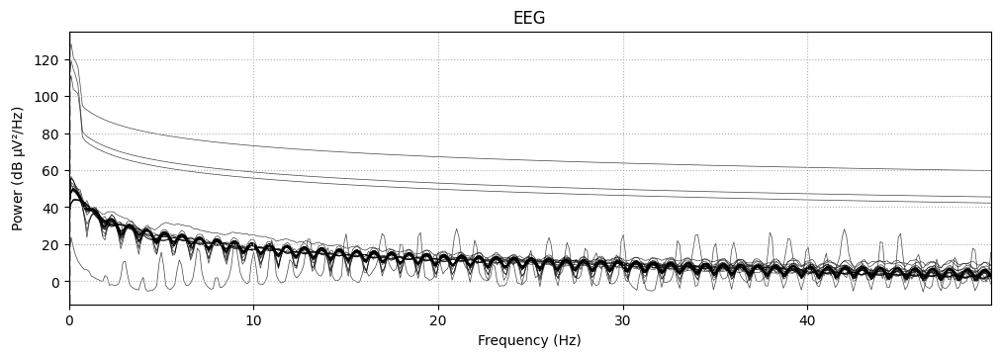

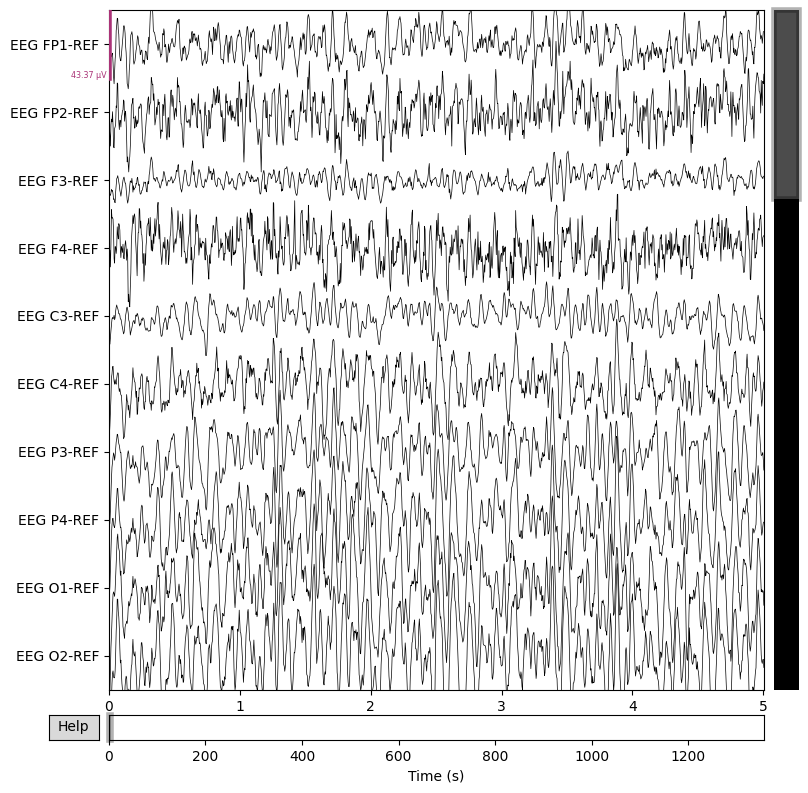

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaancs_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 311039  =      0.000 ...  1214.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 27 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 128.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 27
 projs: []
 sfreq: 256.0 Hz
 subject_info: 3 items (dict)
>


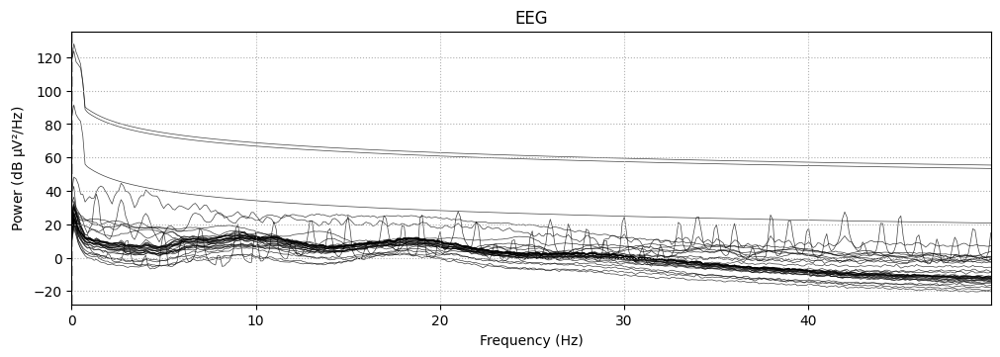

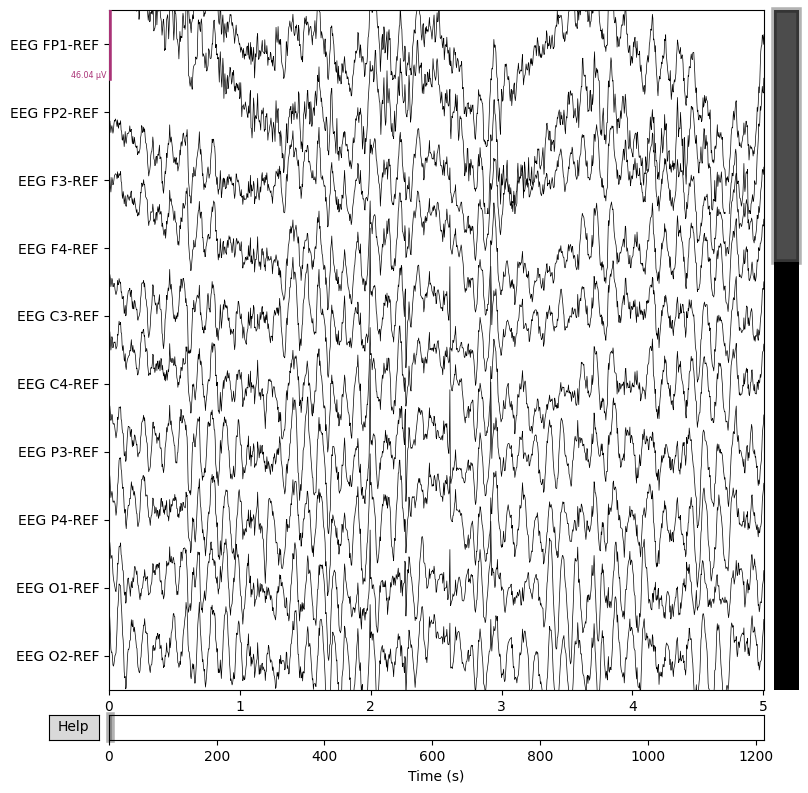

Effective window size : 8.000 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaolv_s002_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:16: UserWarning: Zero value in spectrum for channels IBI, BURSTS, SUPPR
  psd = raw.compute_psd(fmax=50)
<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: UserWarning: Infinite value in PSD for channels IBI, BURSTS, SUPPR.
These channels might be dead.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 437749  =      0.000 ...  1750.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


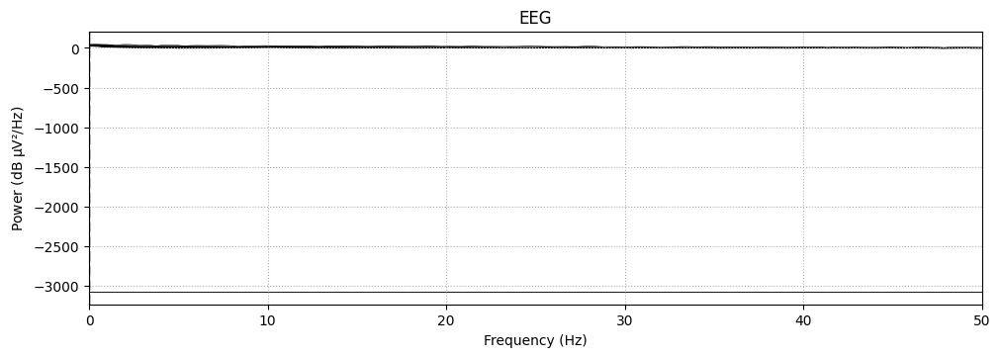

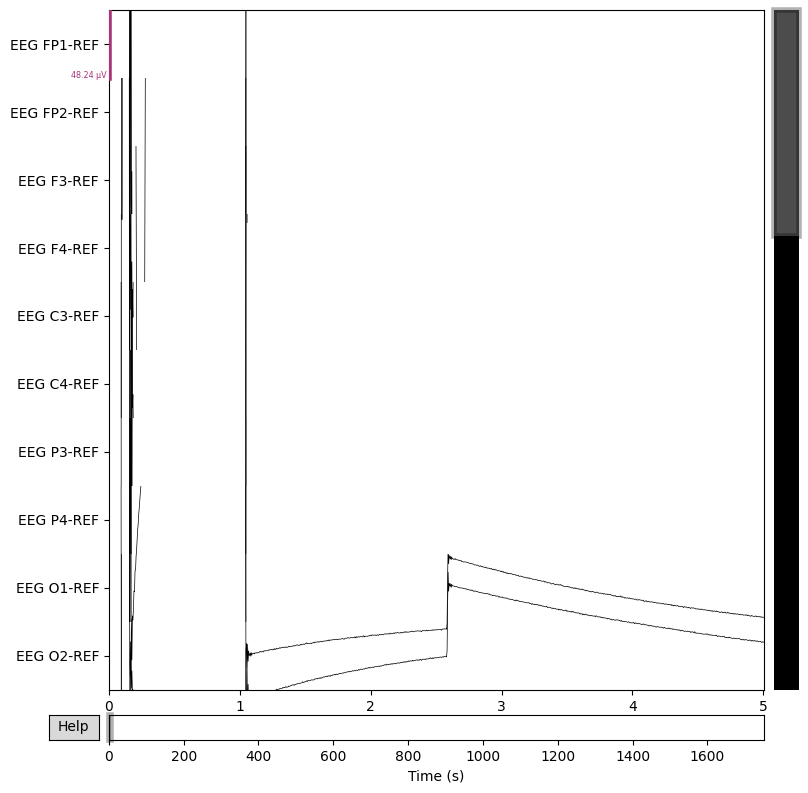

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaimb_s002_t001.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 298499  =      0.000 ...  1193.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2009-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


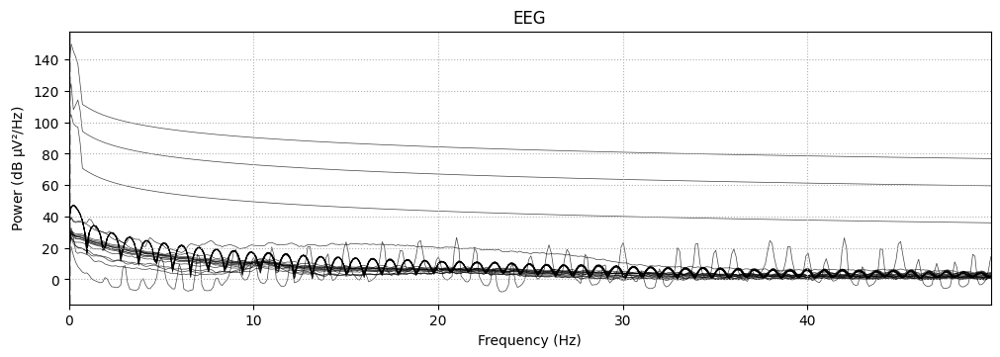

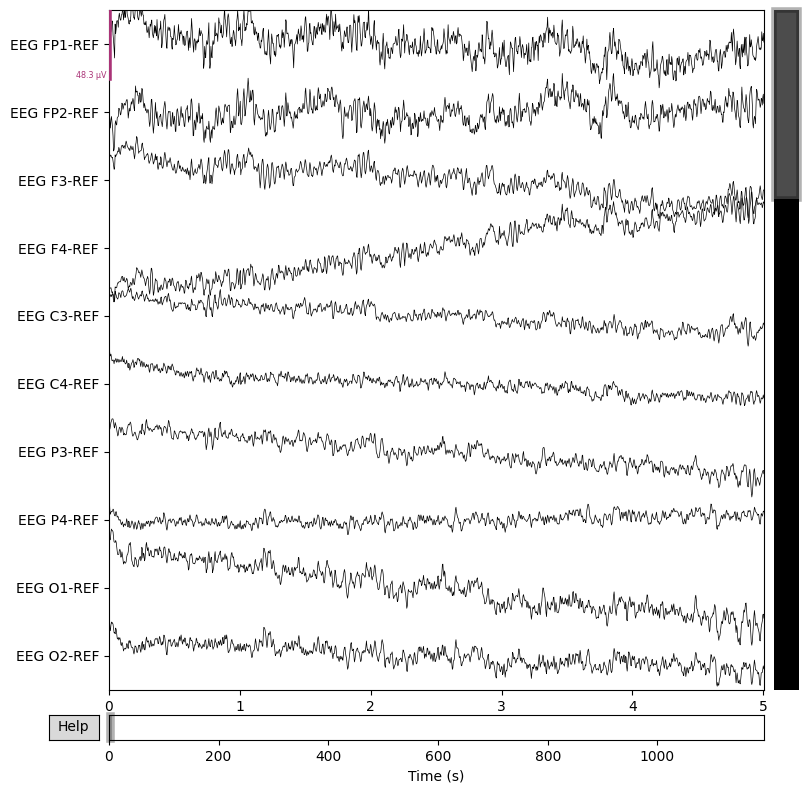

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaabhz_s015_t001.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 300499  =      0.000 ...  1201.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2010-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


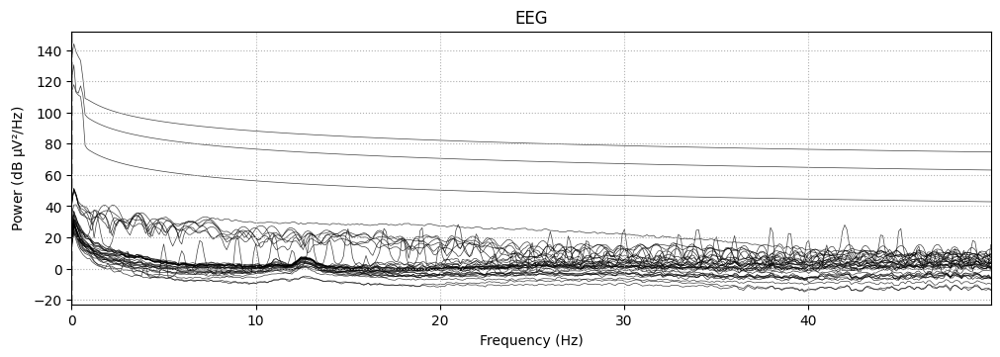

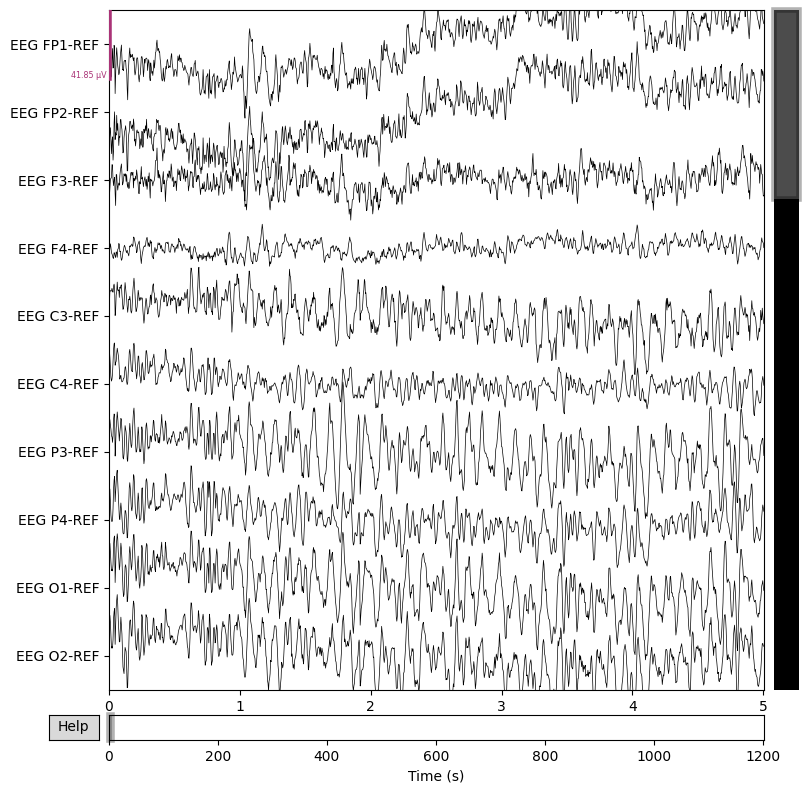

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaptv_s001_t001.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 327999  =      0.000 ...  1311.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


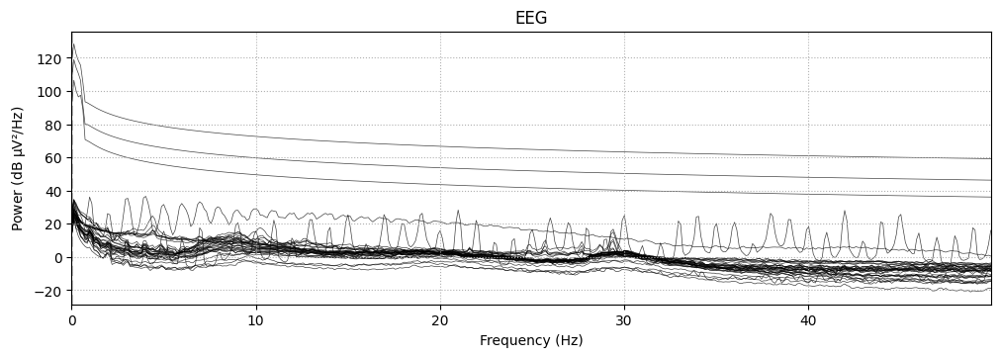

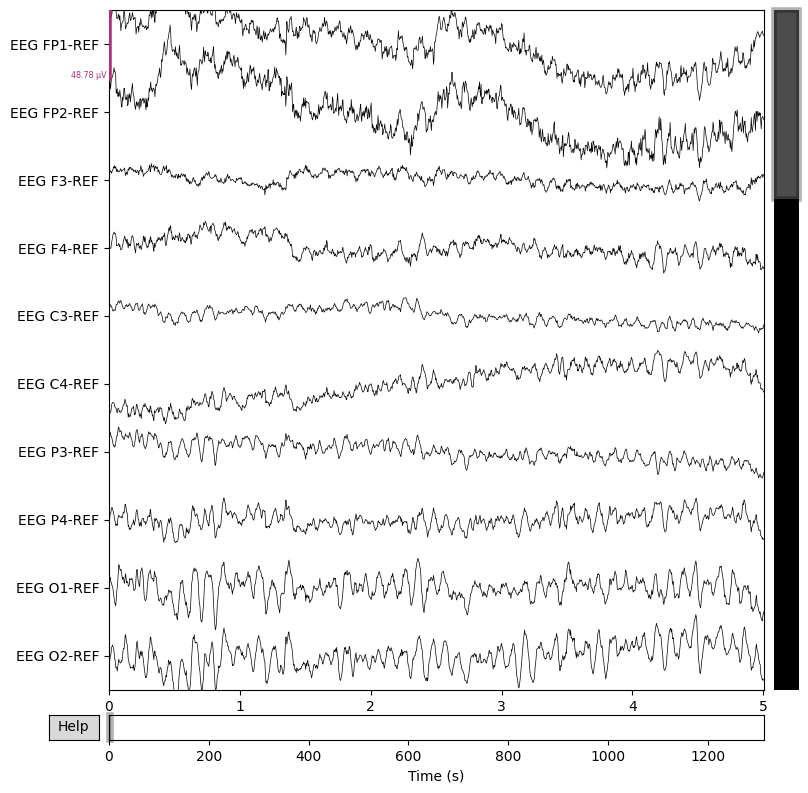

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaanfb_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 316249  =      0.000 ...  1264.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


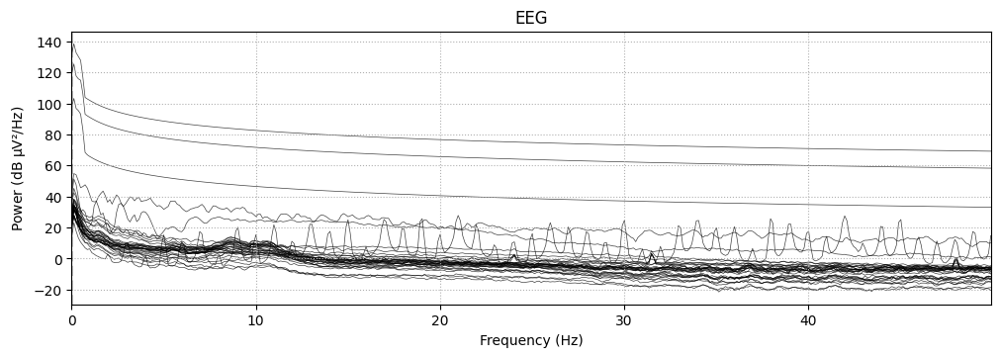

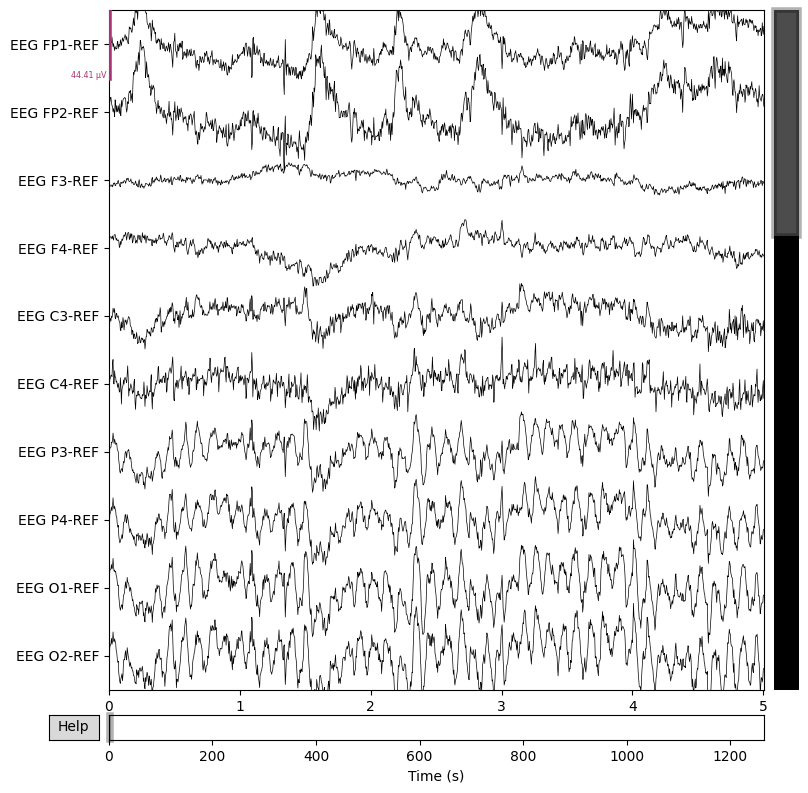

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaeqq_s004_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:16: UserWarning: Zero value in spectrum for channel PHOTIC-REF
  psd = raw.compute_psd(fmax=50)
<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: UserWarning: Infinite value in PSD for channel PHOTIC-REF.
These channels might be dead.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 300999  =      0.000 ...  1203.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


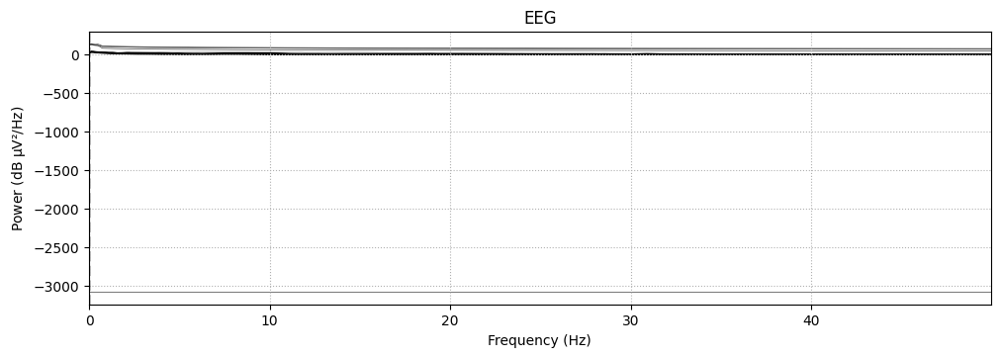

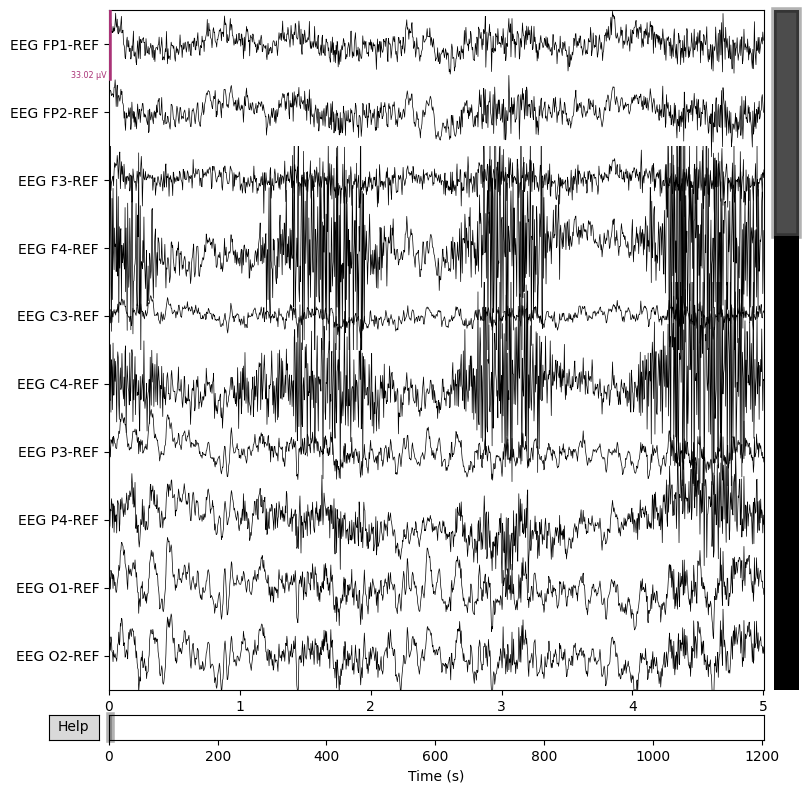

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaamir_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 300749  =      0.000 ...  1202.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2011-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


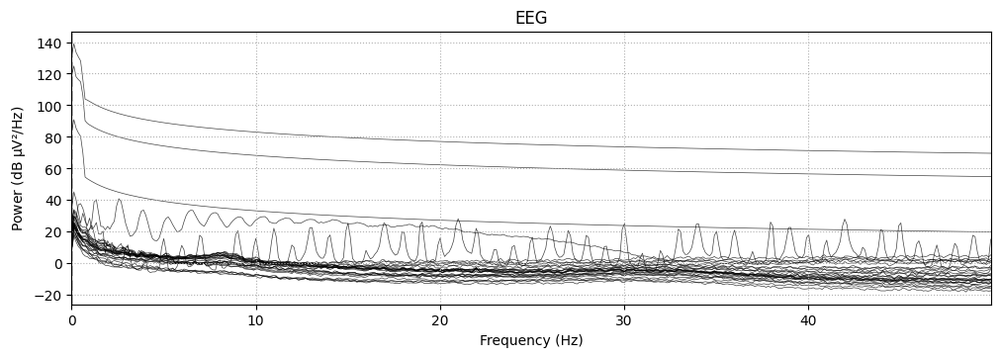

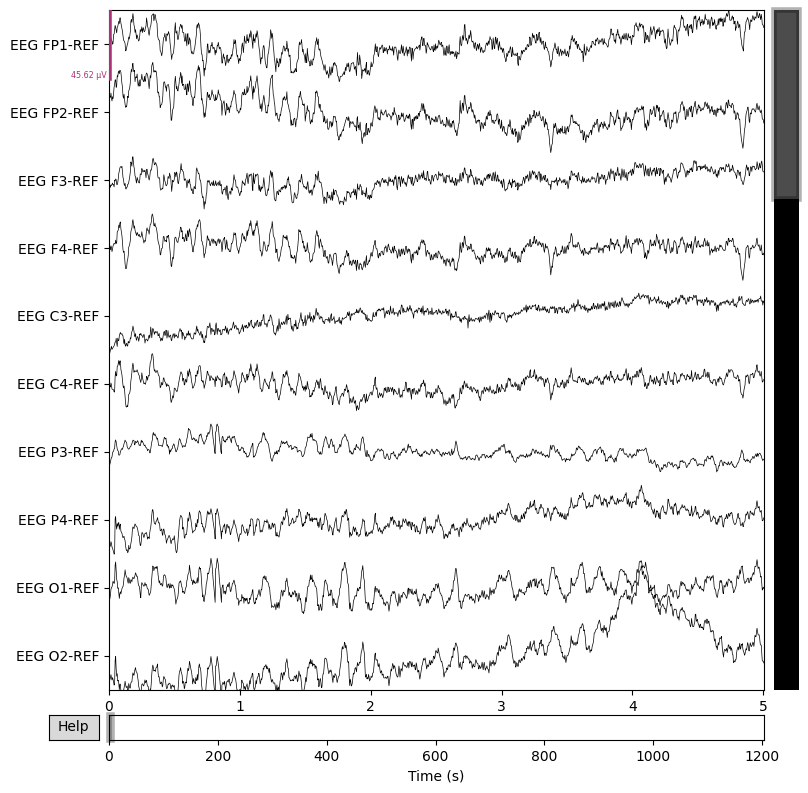

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaahnl_s002_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 330749  =      0.000 ...  1322.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


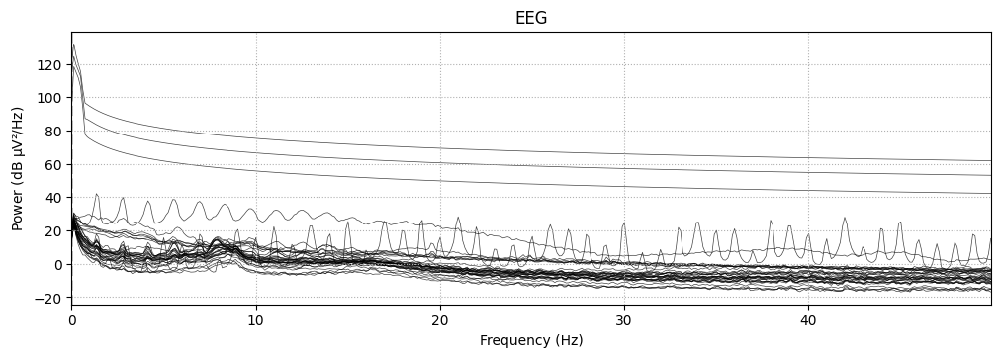

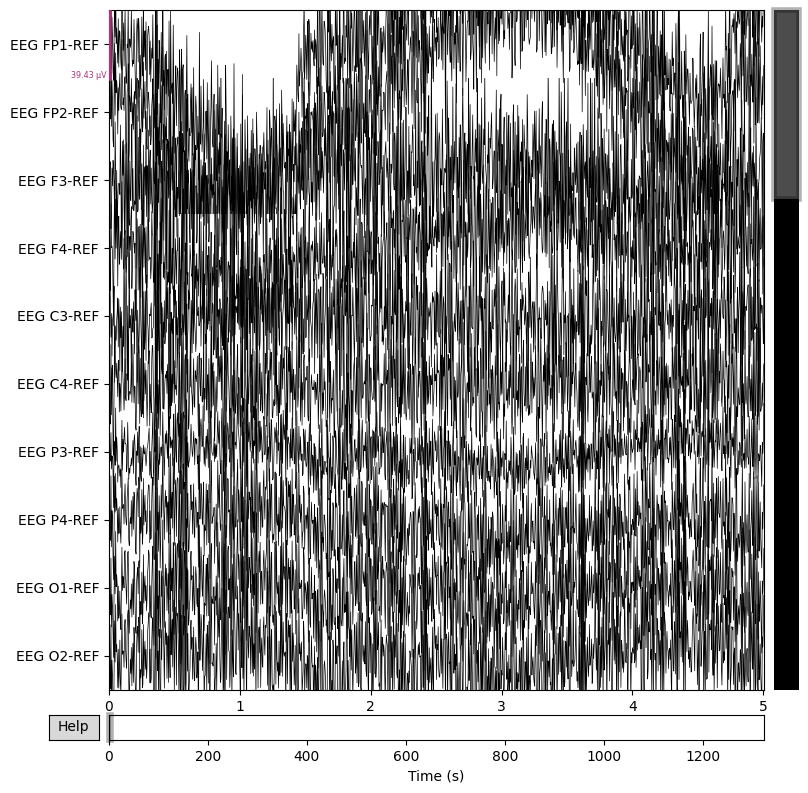

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaamyh_s001_t002.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 240749  =      0.000 ...   962.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


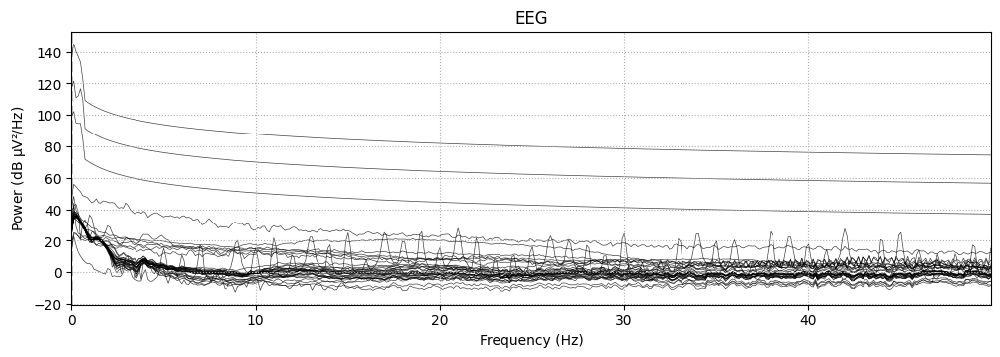

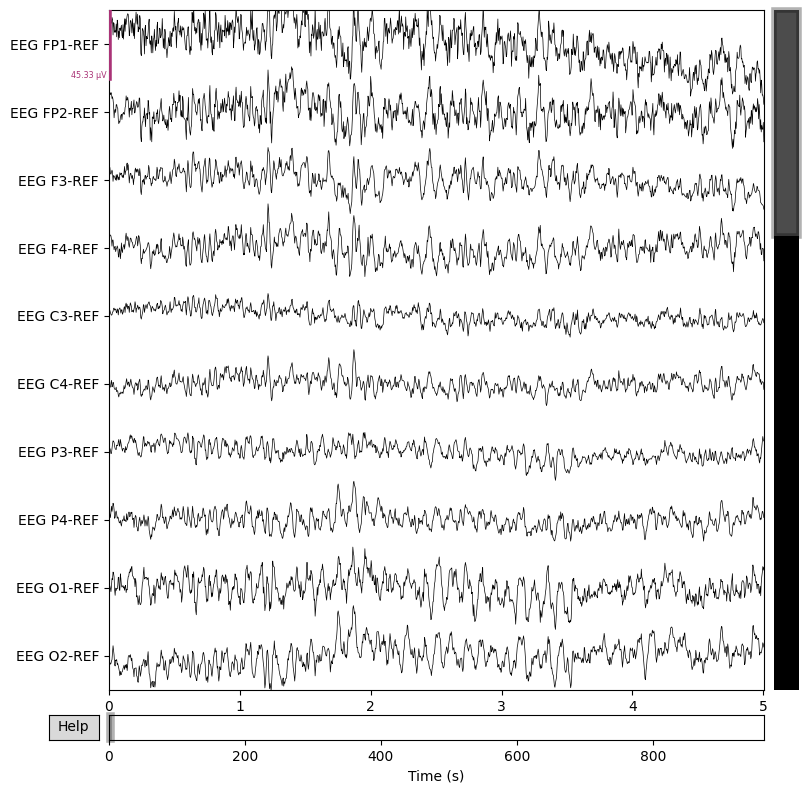

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaajei_s004_t001.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 296249  =      0.000 ...  1184.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2010-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


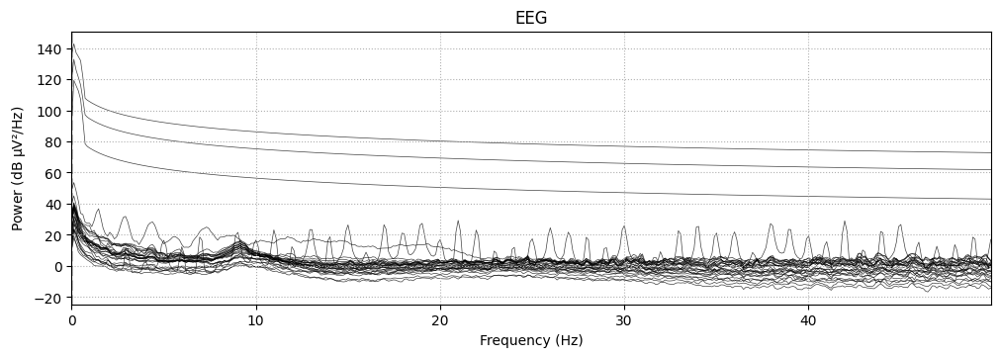

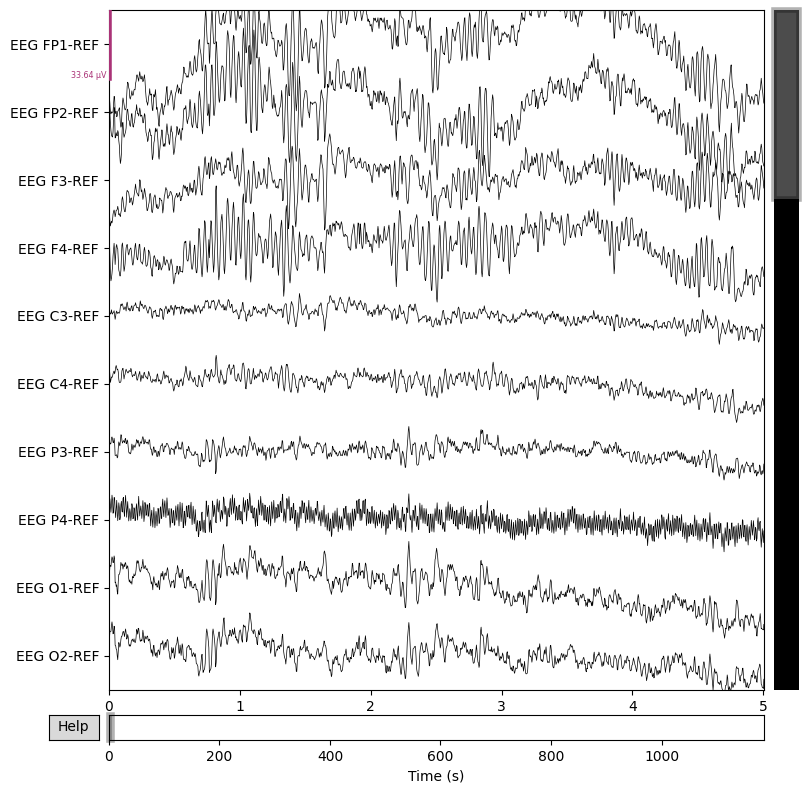

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaopc_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 312499  =      0.000 ...  1249.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


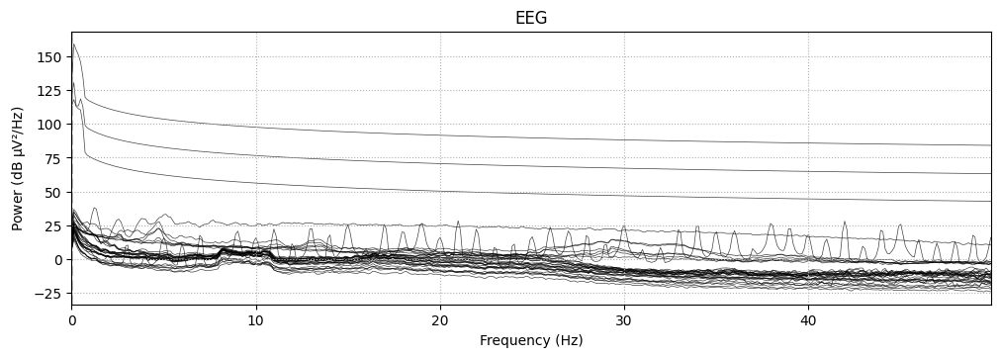

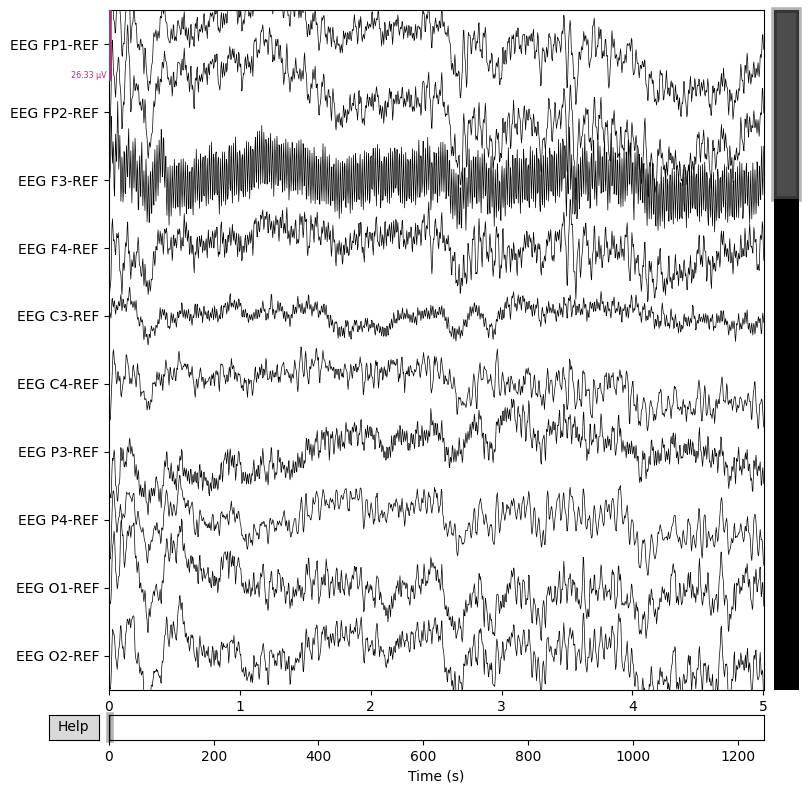

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaakwv_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:16: UserWarning: Zero value in spectrum for channel PHOTIC-REF
  psd = raw.compute_psd(fmax=50)
<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: UserWarning: Infinite value in PSD for channel PHOTIC-REF.
These channels might be dead.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 371499  =      0.000 ...  1485.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2010-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


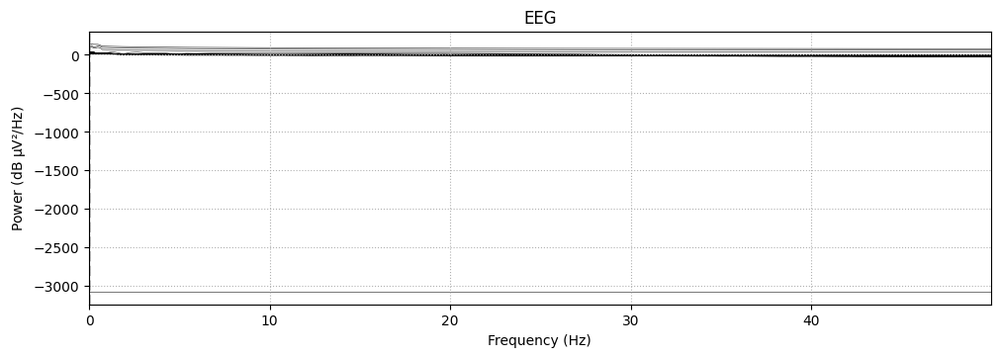

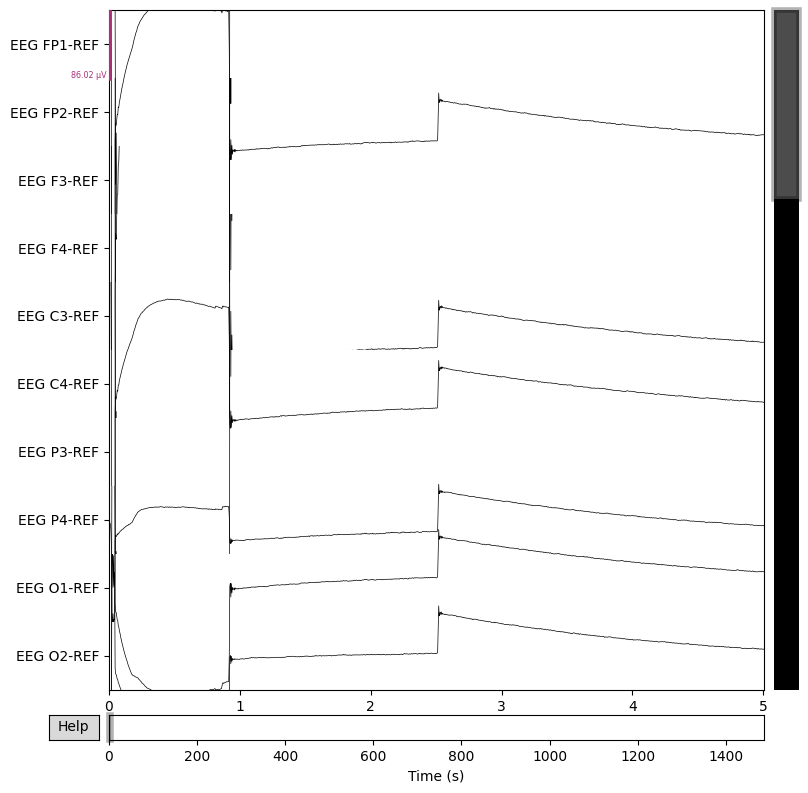

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaolk_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 357249  =      0.000 ...  1428.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 31 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 31
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


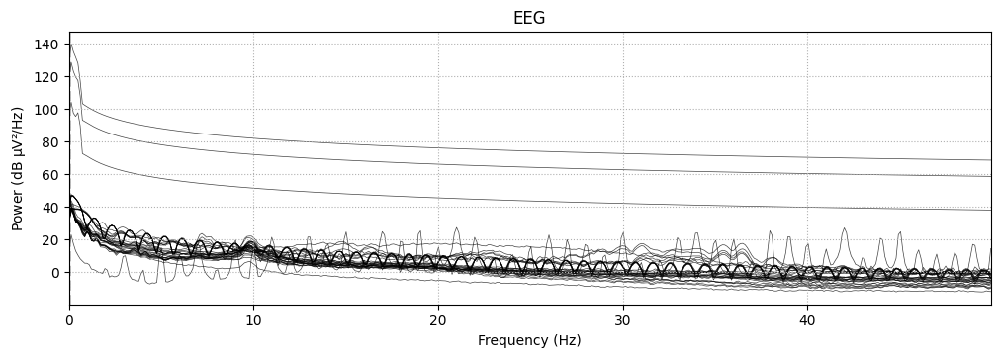

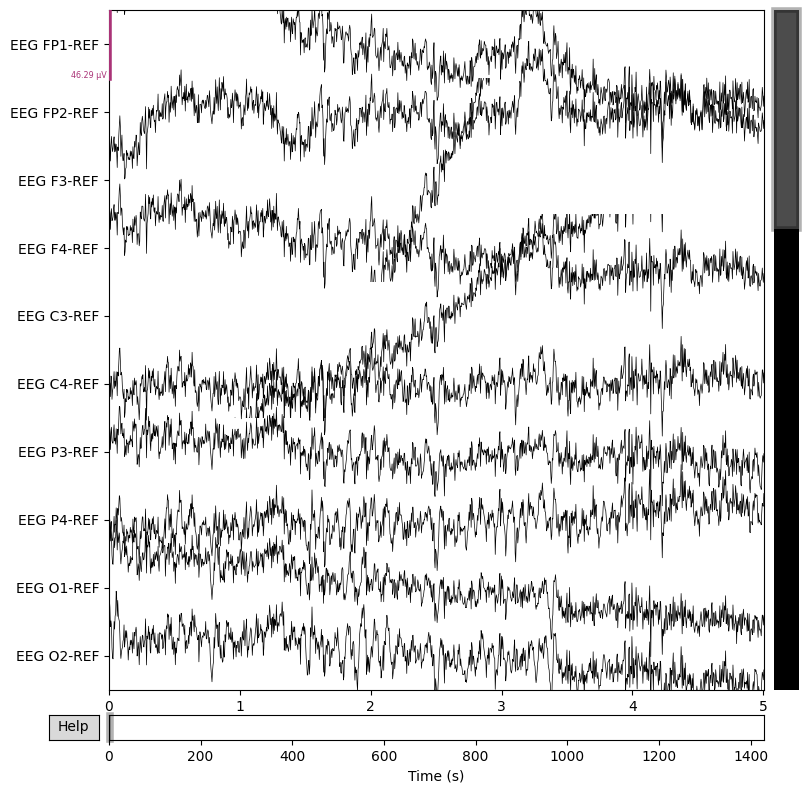

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaabnq_s002_t001.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 297749  =      0.000 ...  1190.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2010-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


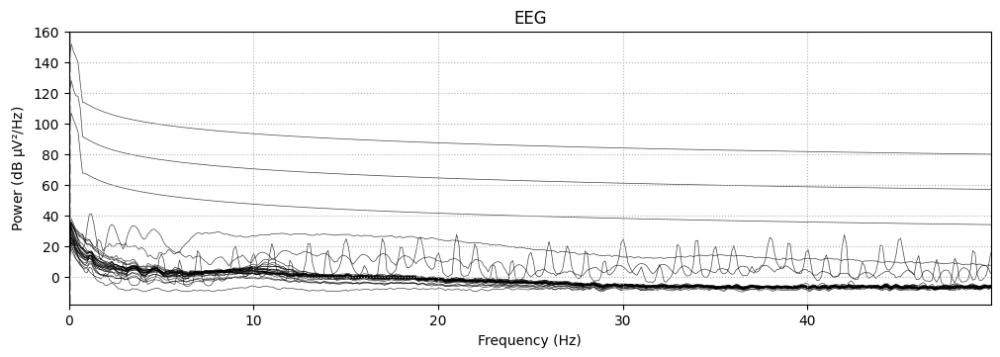

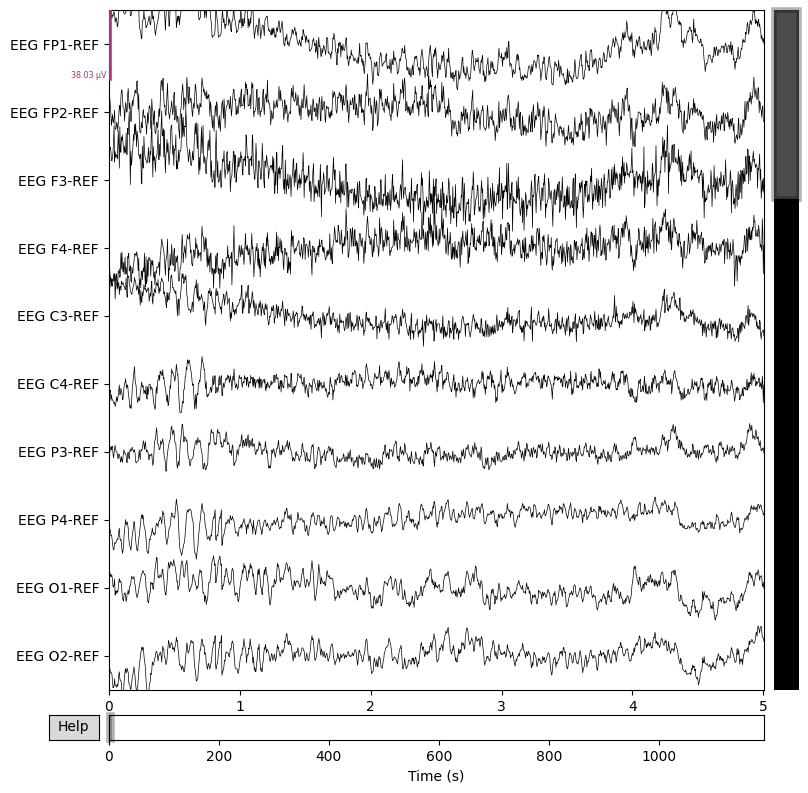

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaoiz_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 368499  =      0.000 ...  1473.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


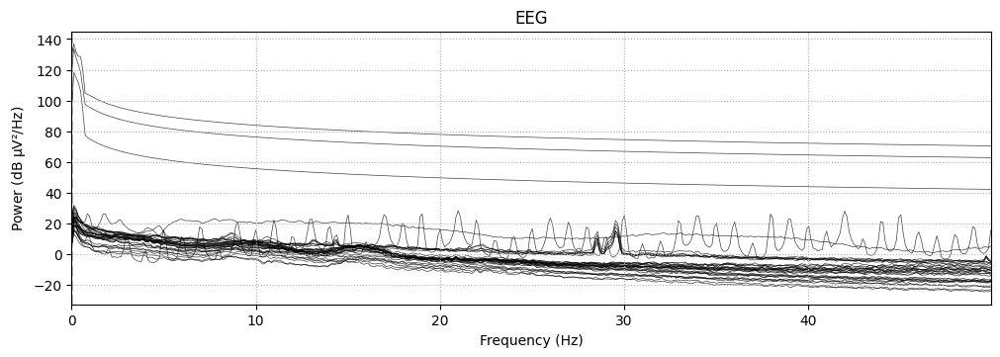

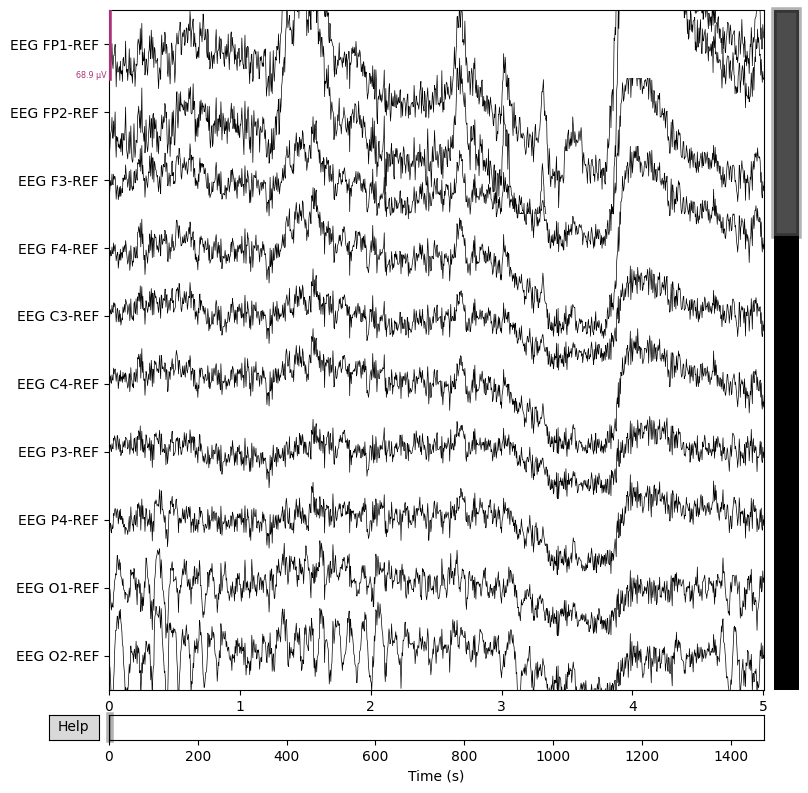

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaamkf_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 308223  =      0.000 ...  1203.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 34 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 128.0 Hz
 meas_date: 2011-01-01 00:00:00 UTC
 nchan: 34
 projs: []
 sfreq: 256.0 Hz
 subject_info: 3 items (dict)
>


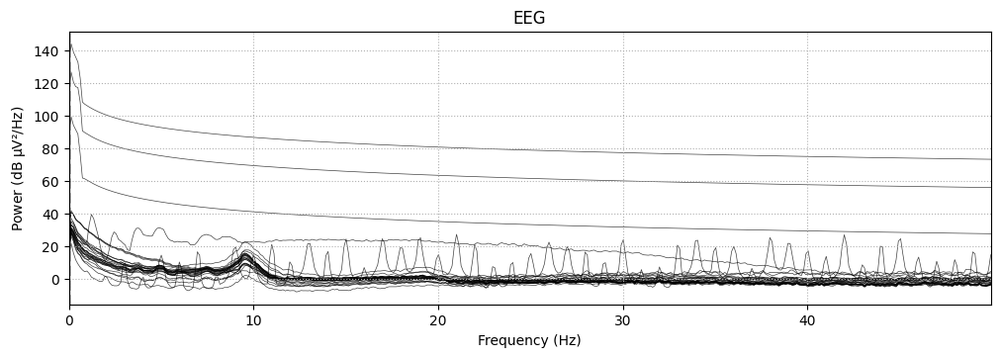

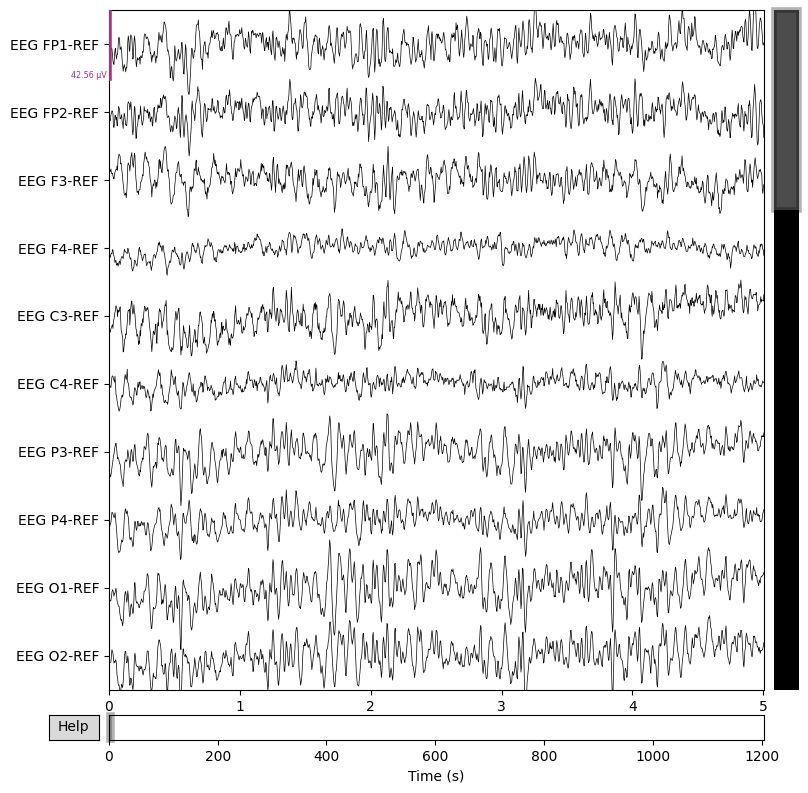

Effective window size : 8.000 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaowf_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 323327  =      0.000 ...  1262.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 28 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 128.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 28
 projs: []
 sfreq: 256.0 Hz
 subject_info: 3 items (dict)
>


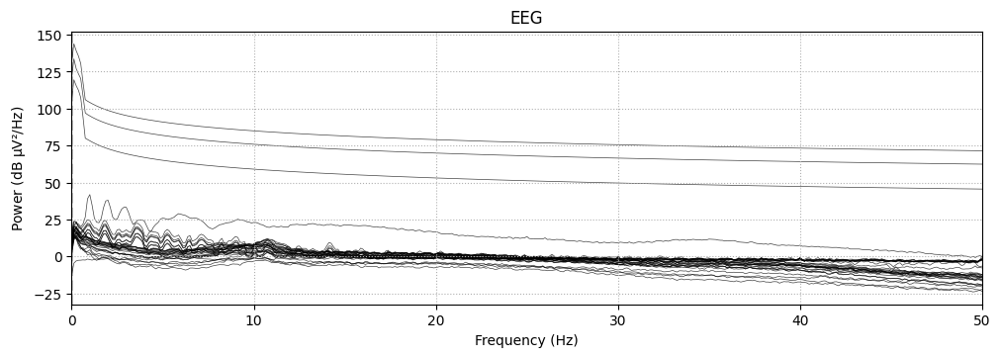

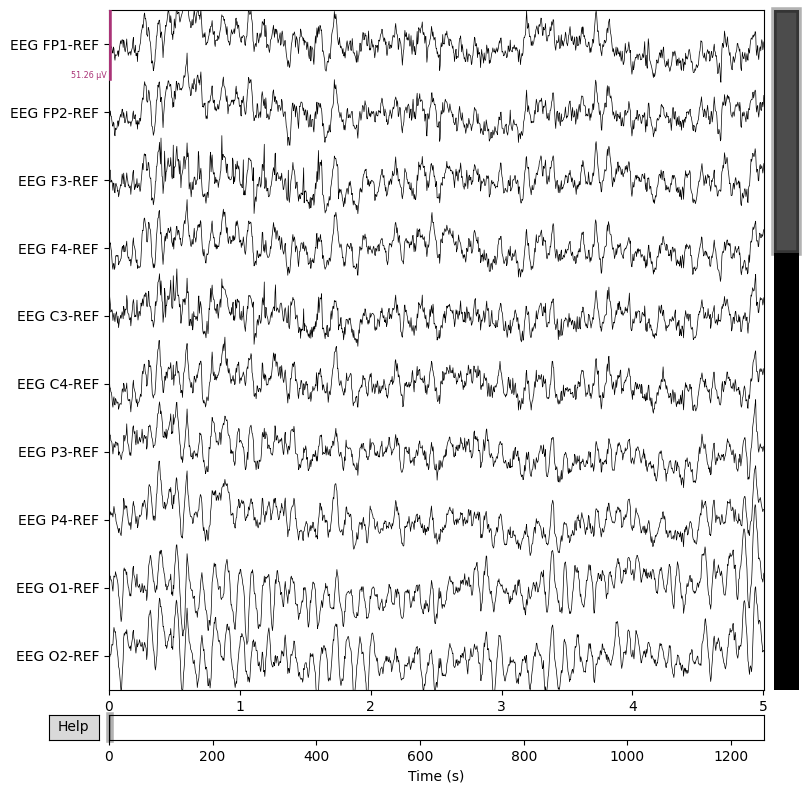

Effective window size : 8.000 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaalrt_s002_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 346249  =      0.000 ...  1384.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


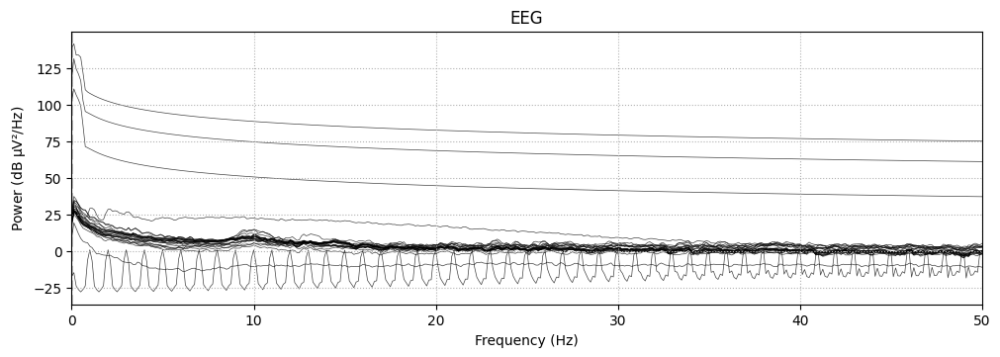

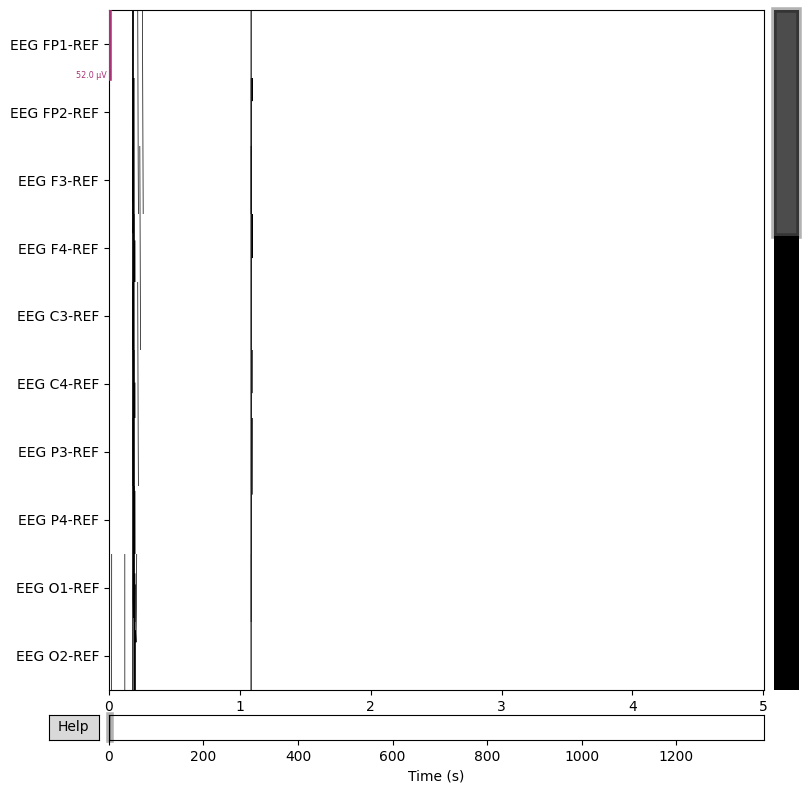

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaajfo_s002_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 302999  =      0.000 ...  1211.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2011-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


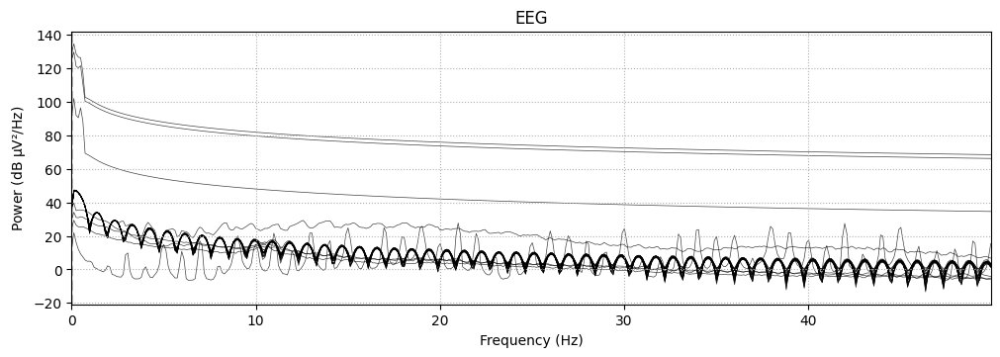

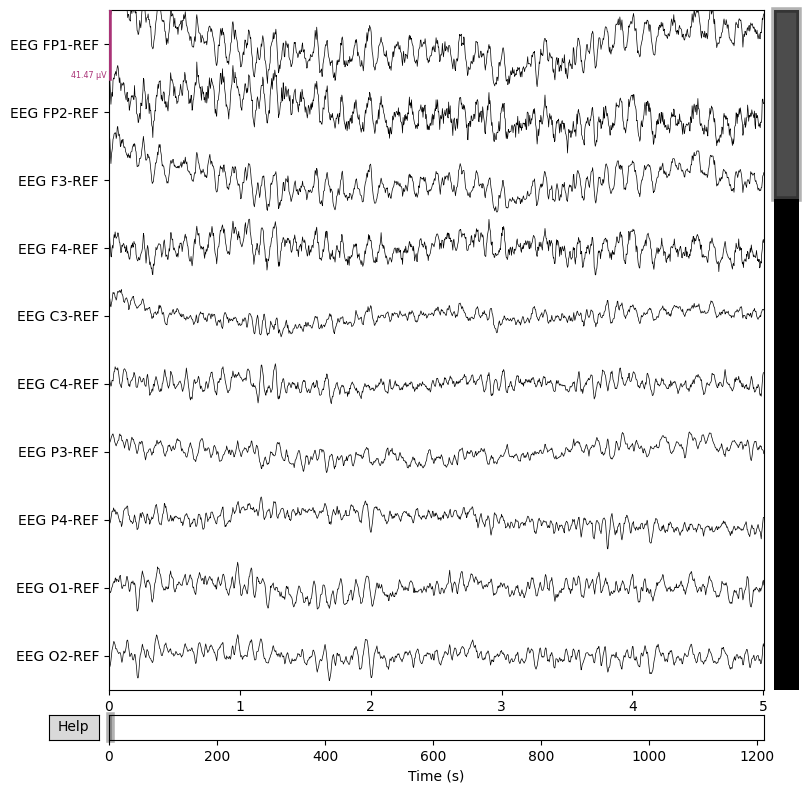

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaamnw_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 470749  =      0.000 ...  1882.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


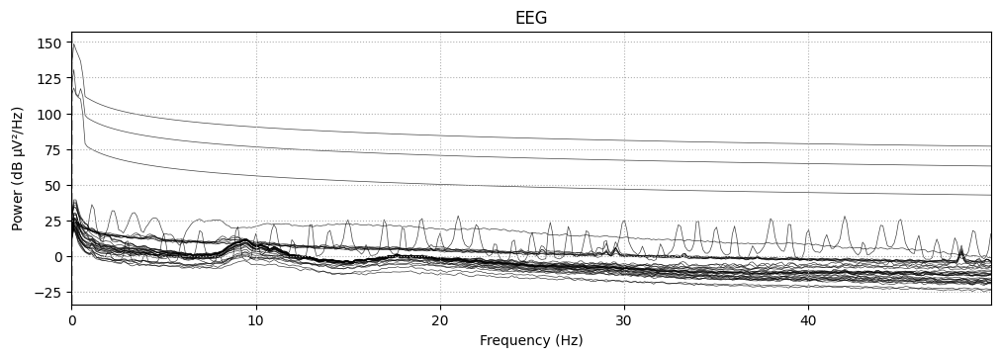

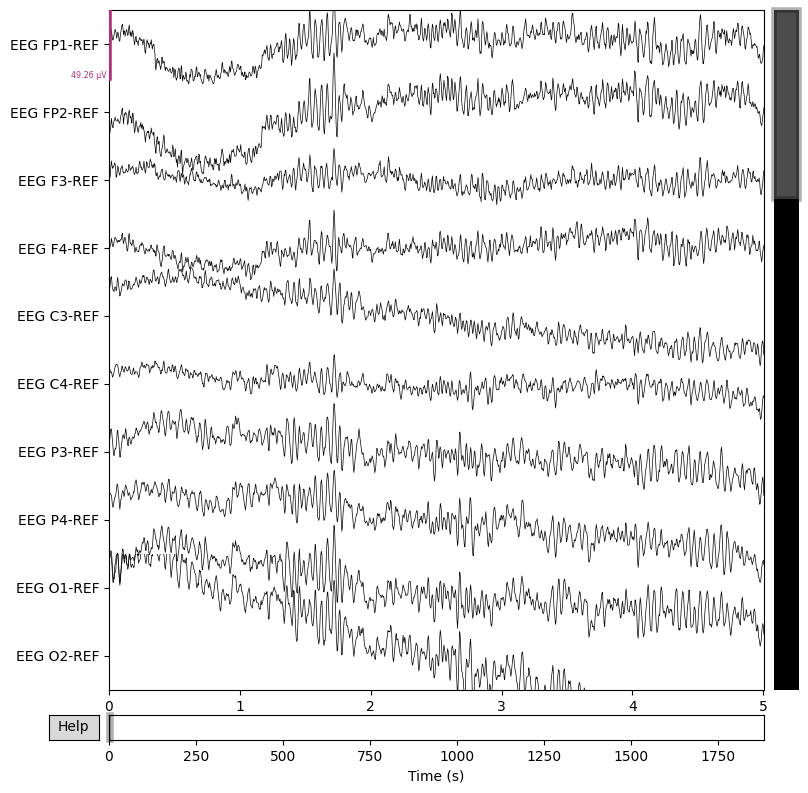

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaalla_s001_t001.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 271999  =      0.000 ...  1087.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2011-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


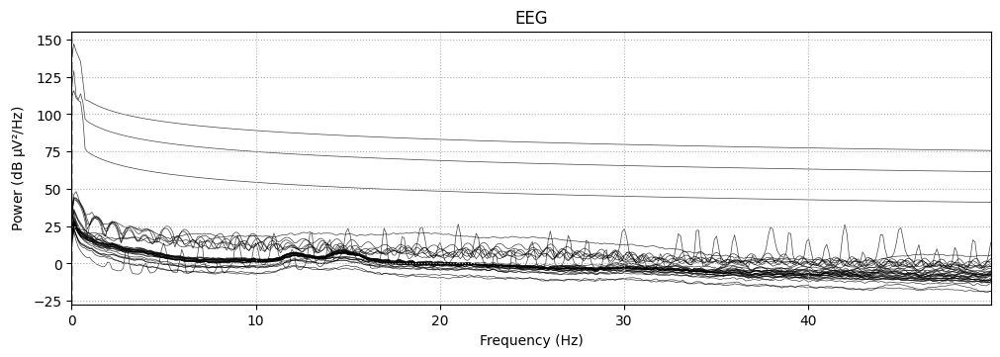

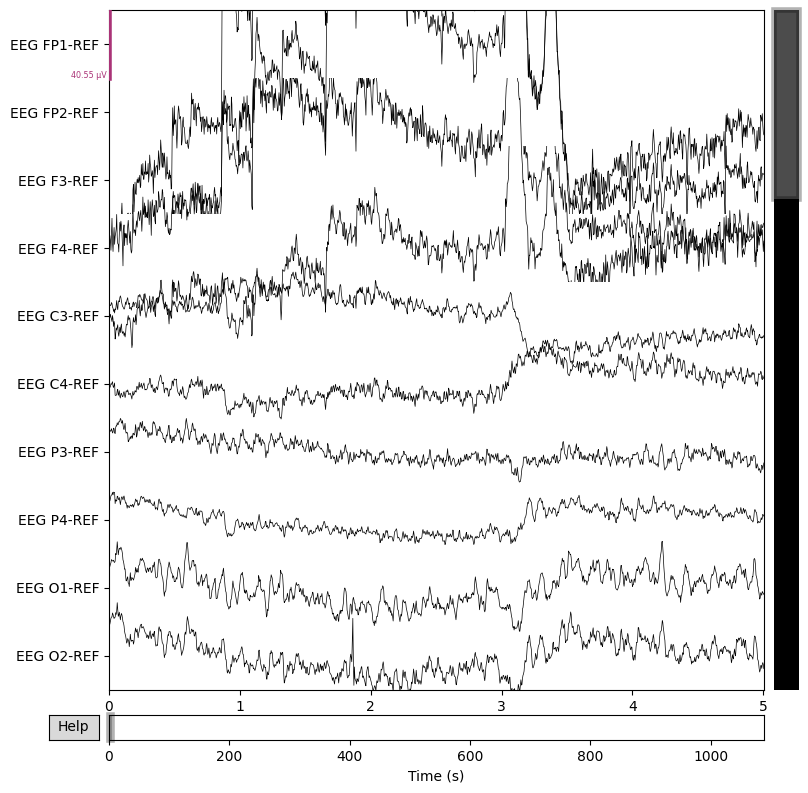

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaakub_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 311249  =      0.000 ...  1244.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2010-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


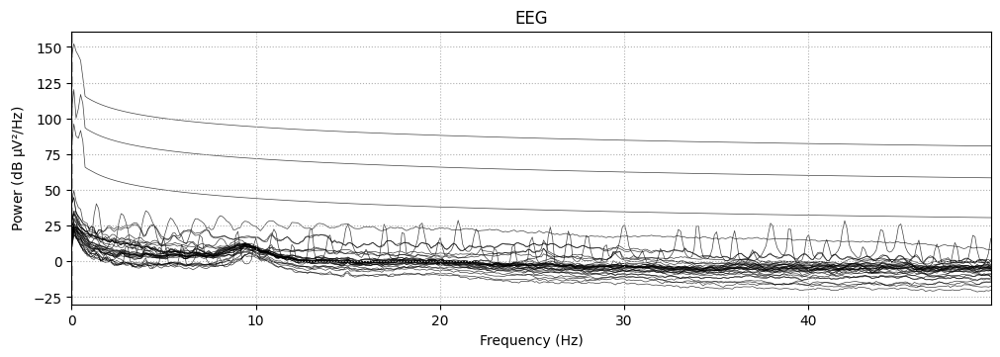

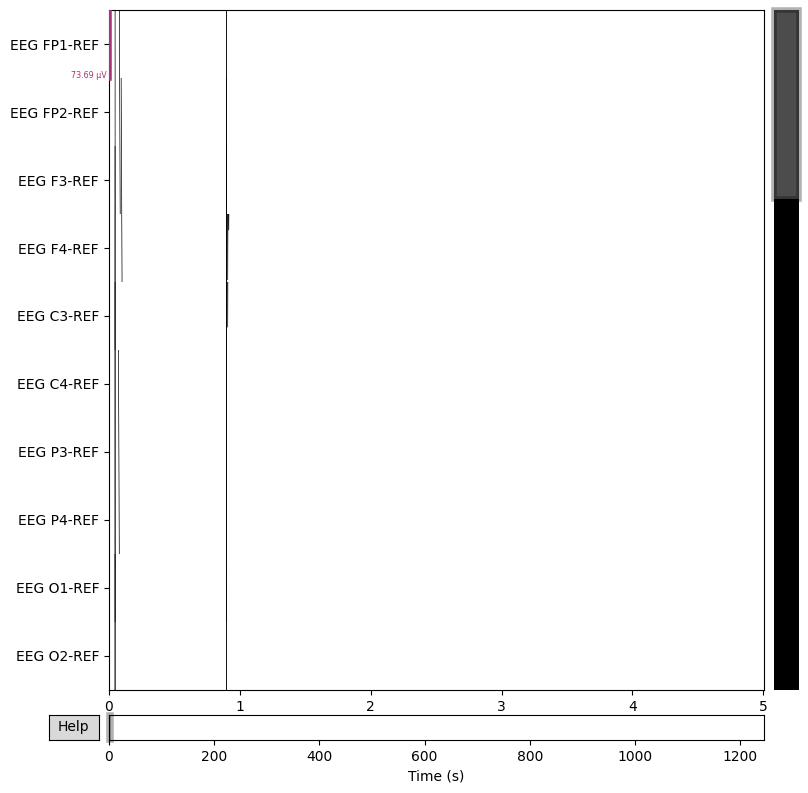

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaibr_s005_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 318999  =      0.000 ...  1275.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


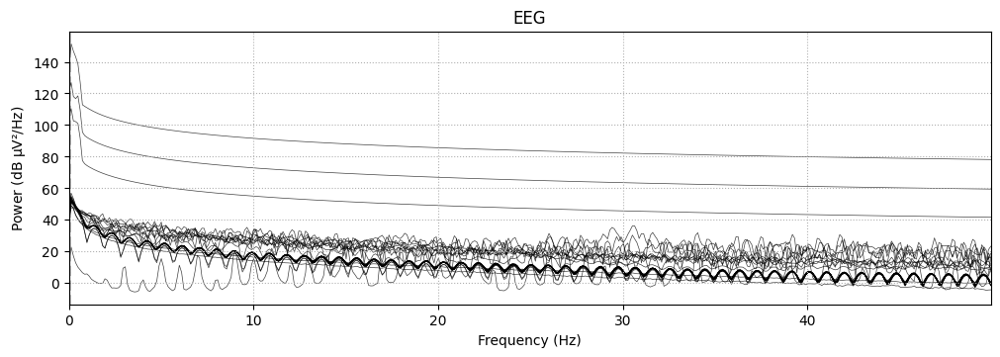

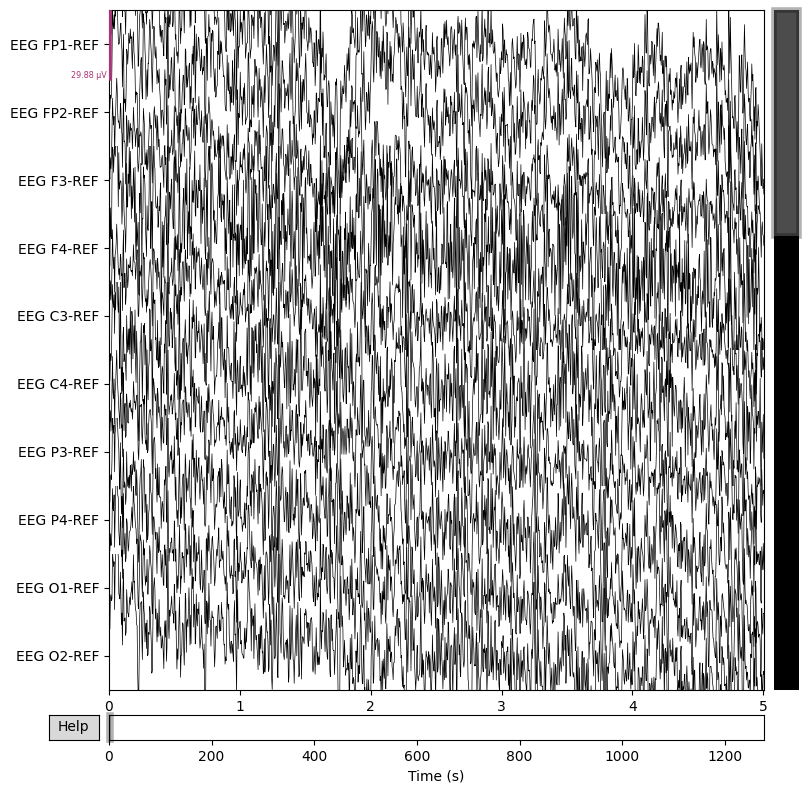

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaprk_s001_t001.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:16: UserWarning: Zero value in spectrum for channel PHOTIC-REF
  psd = raw.compute_psd(fmax=50)
<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: UserWarning: Infinite value in PSD for channel PHOTIC-REF.
These channels might be dead.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 331249  =      0.000 ...  1324.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


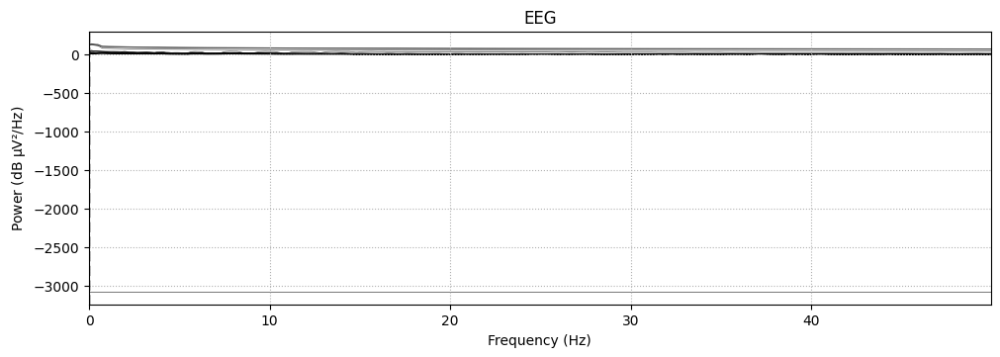

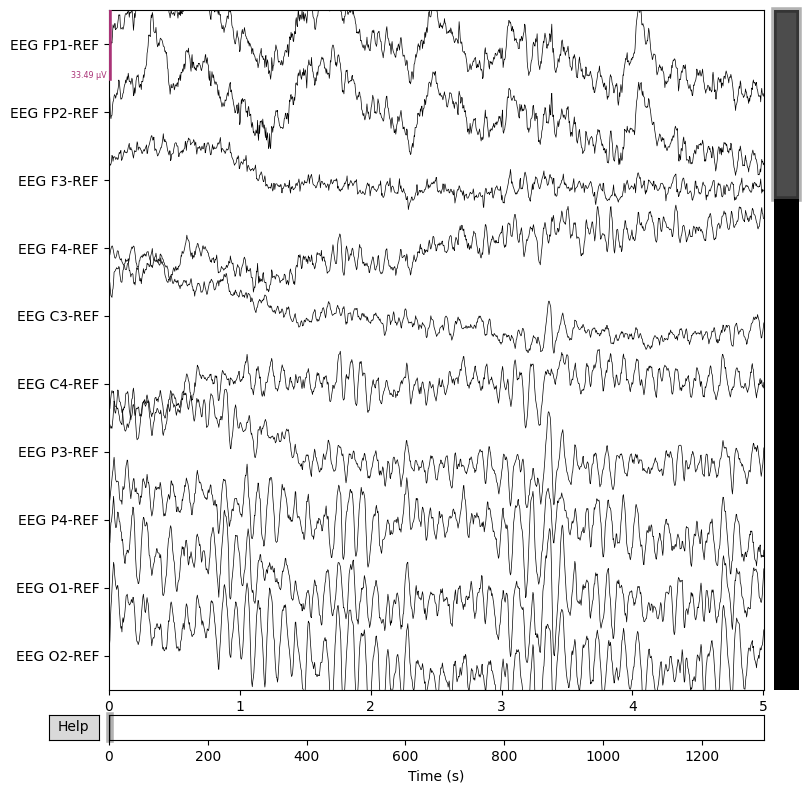

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaapbu_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 351999  =      0.000 ...  1407.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


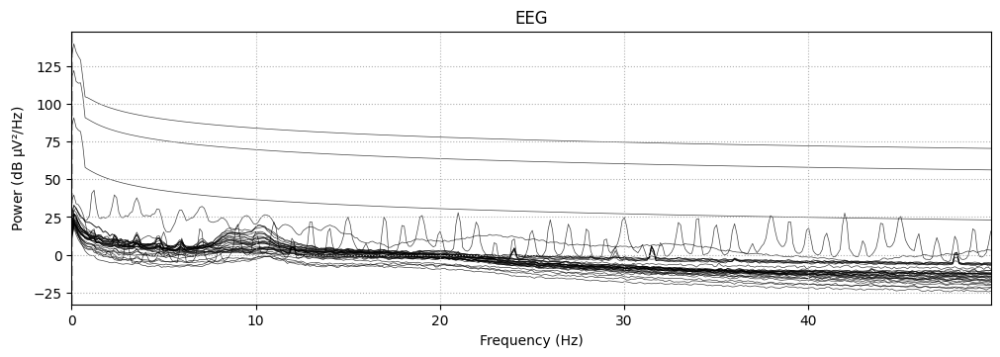

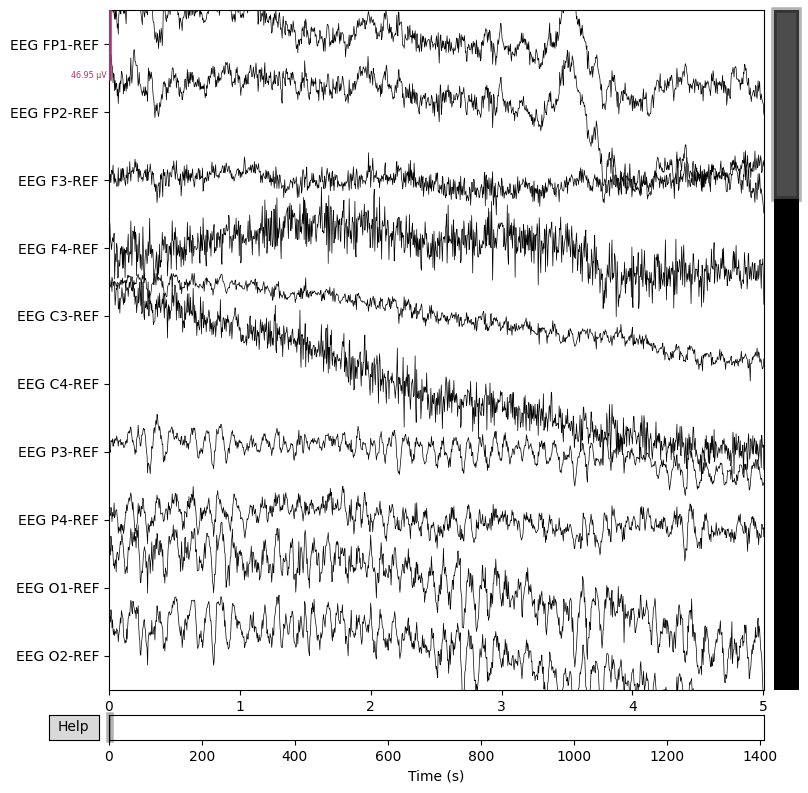

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaapqs_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 308999  =      0.000 ...  1235.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


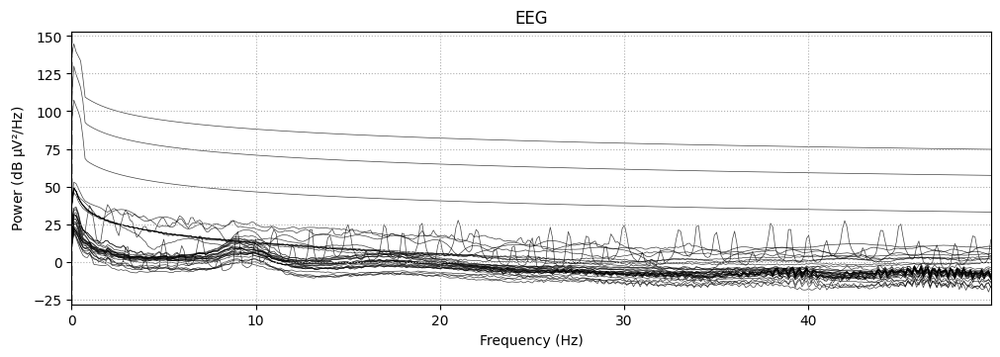

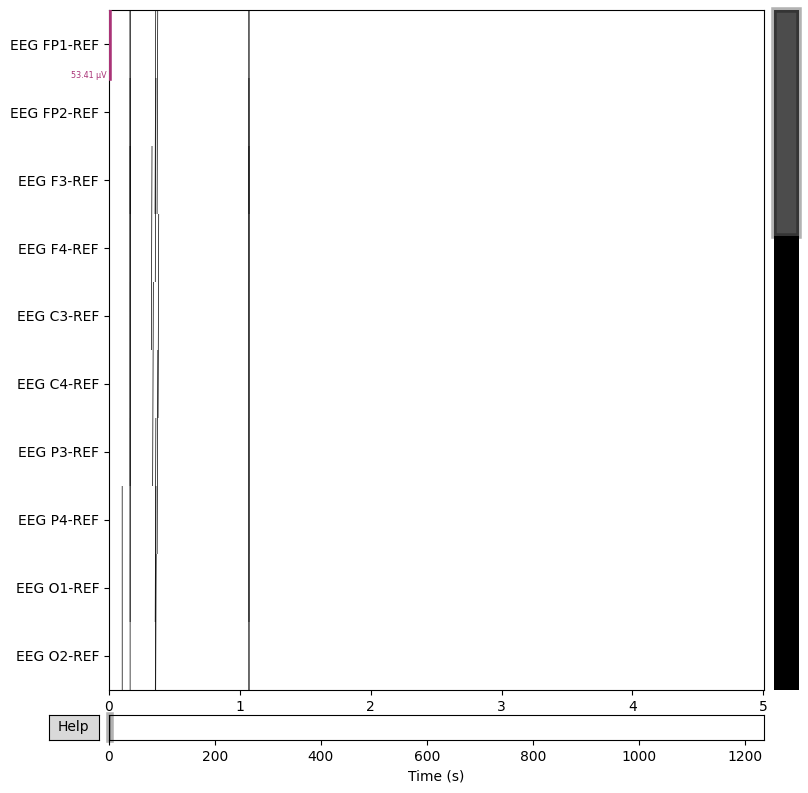

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaansy_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 323749  =      0.000 ...  1294.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


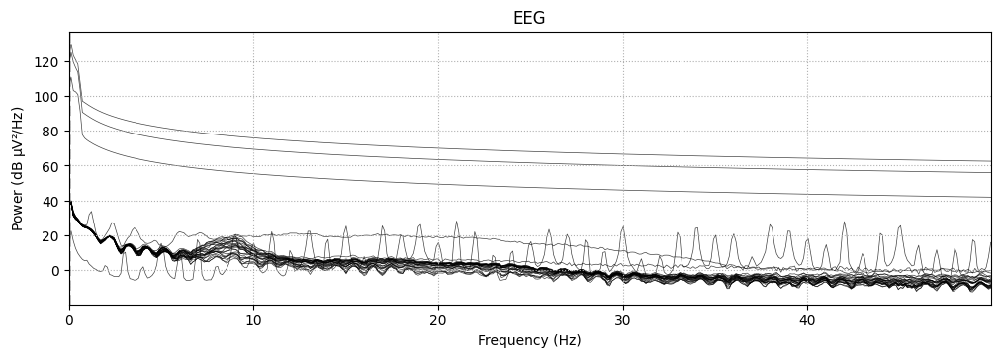

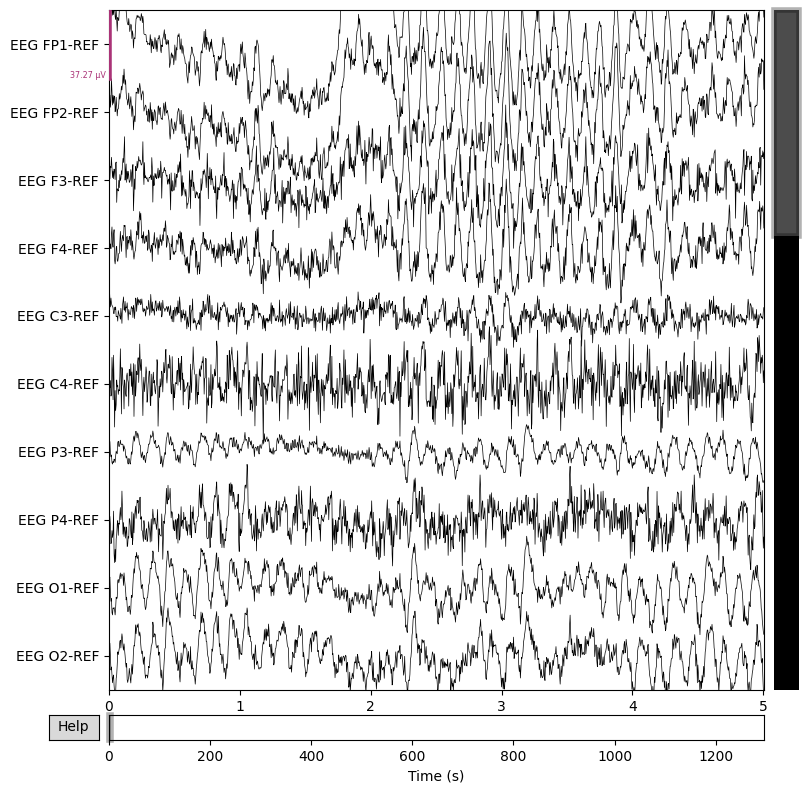

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaokn_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 300999  =      0.000 ...  1203.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2011-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


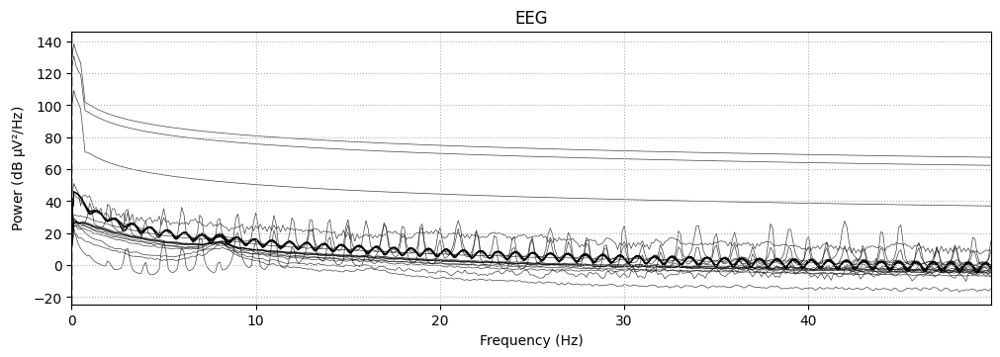

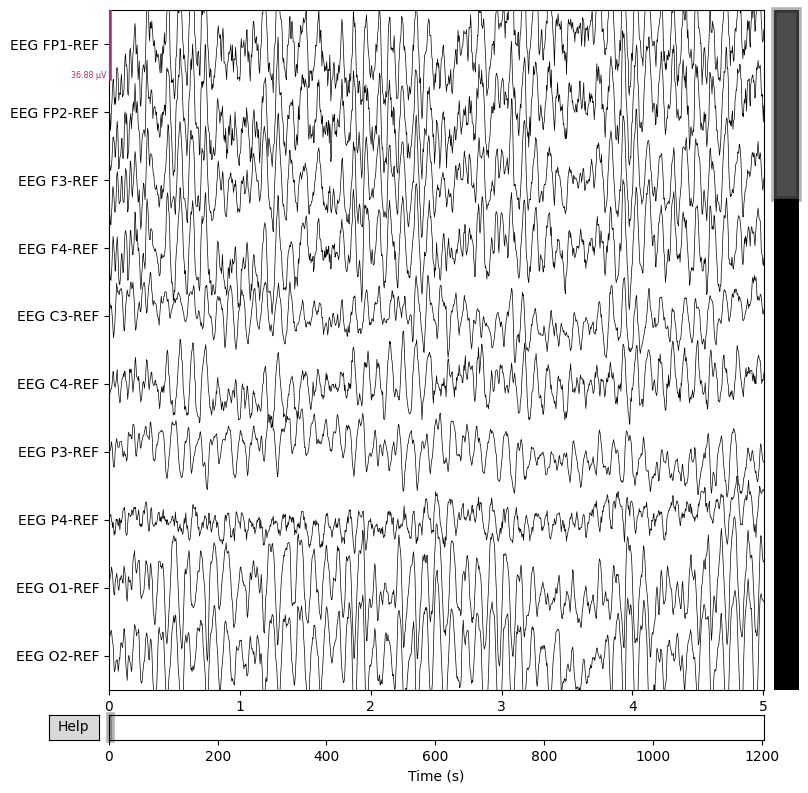

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaakps_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:16: UserWarning: Zero value in spectrum for channels IBI, BURSTS, SUPPR
  psd = raw.compute_psd(fmax=50)
<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: UserWarning: Infinite value in PSD for channels IBI, BURSTS, SUPPR.
These channels might be dead.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 301249  =      0.000 ...  1204.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2010-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


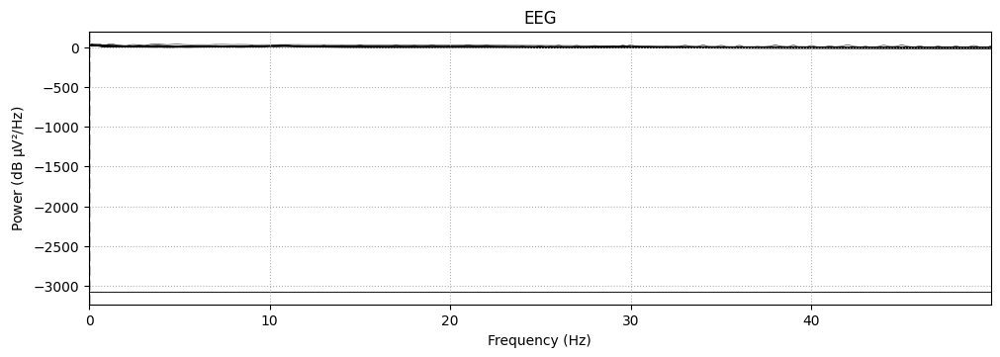

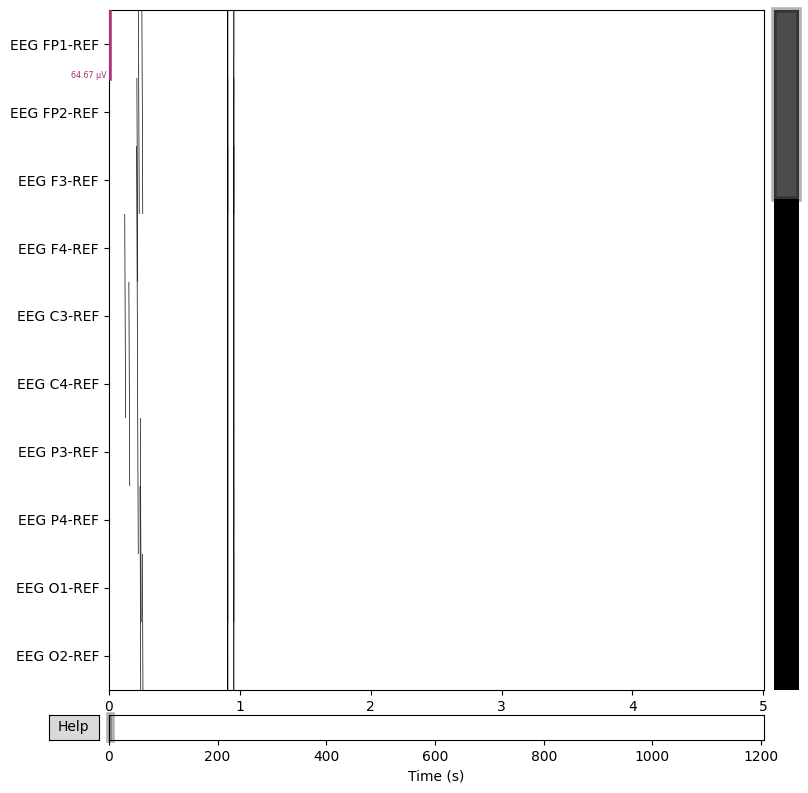

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaapgd_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:16: UserWarning: Zero value in spectrum for channel PHOTIC-REF
  psd = raw.compute_psd(fmax=50)
<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: UserWarning: Infinite value in PSD for channel PHOTIC-REF.
These channels might be dead.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 409999  =      0.000 ...  1639.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


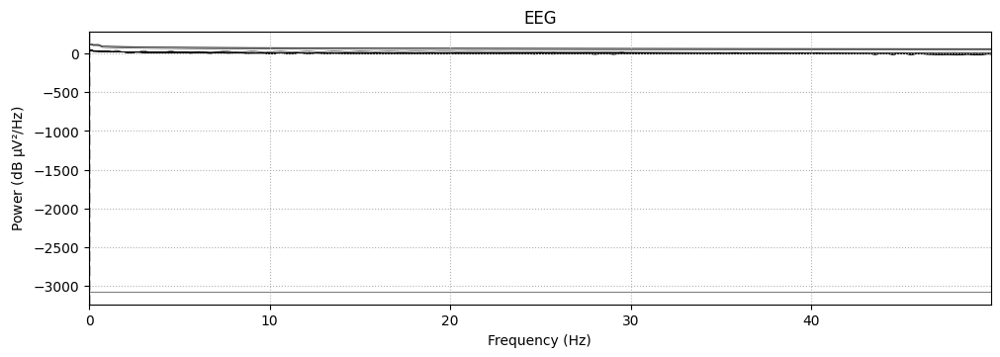

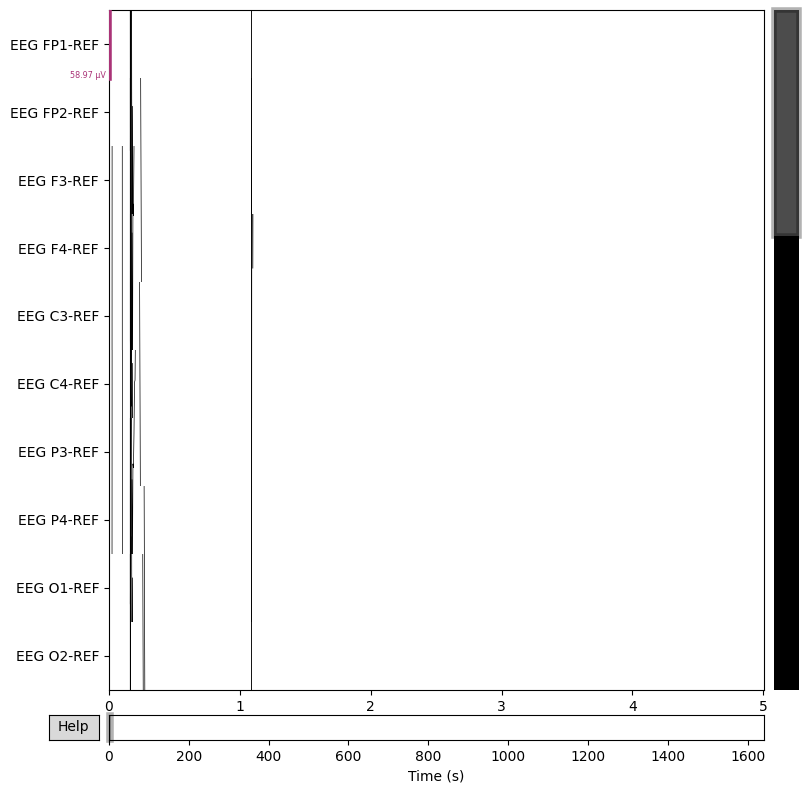

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaljh_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 363249  =      0.000 ...  1452.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2011-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


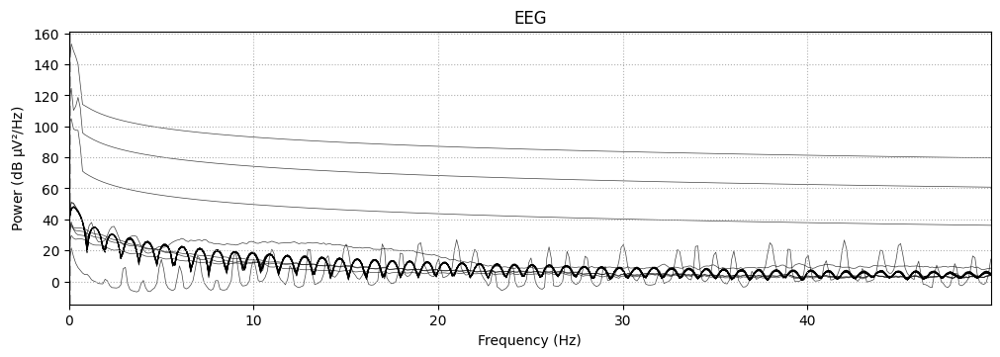

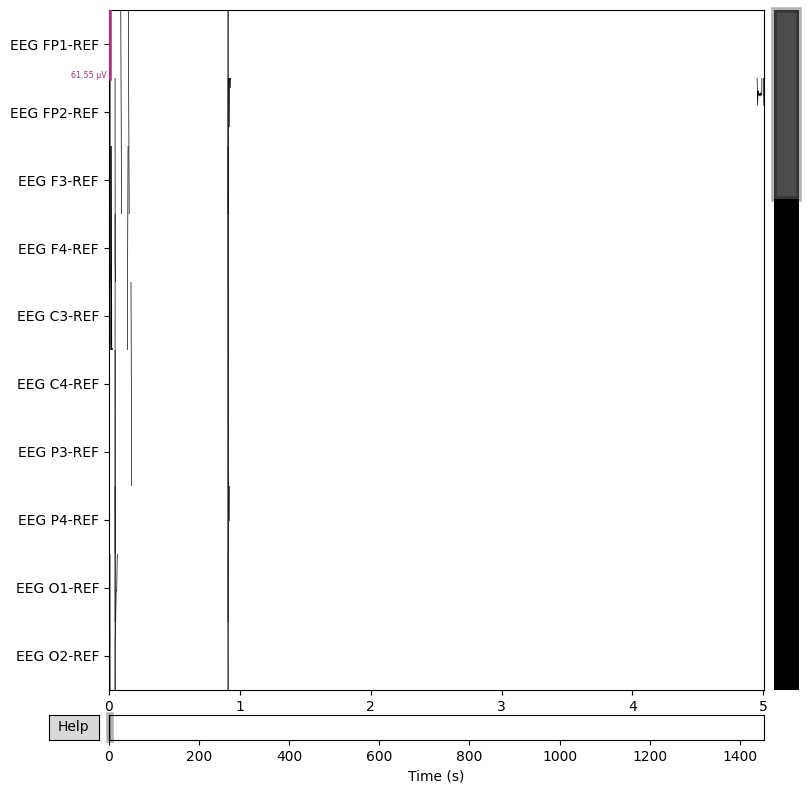

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaairn_s002_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 314249  =      0.000 ...  1256.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2010-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


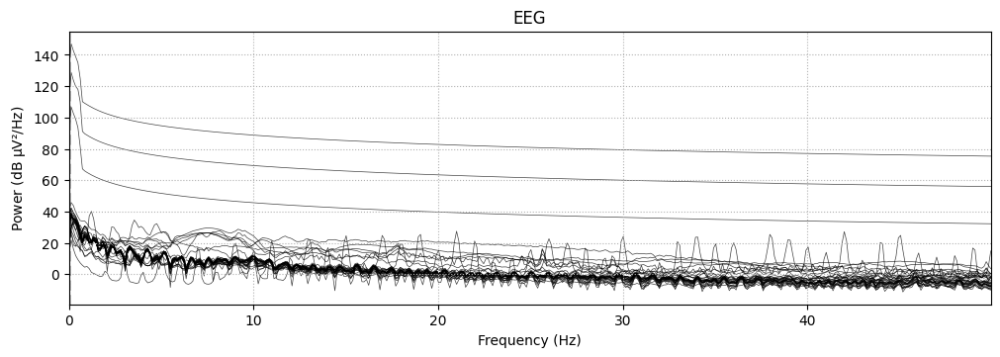

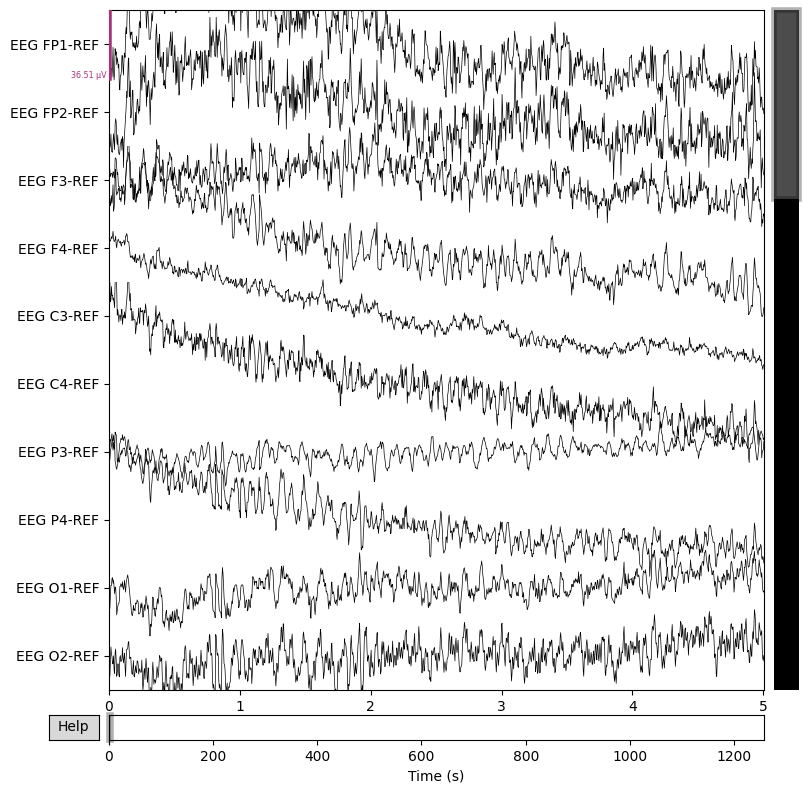

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaajcv_s002_t001.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 298749  =      0.000 ...  1194.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2011-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


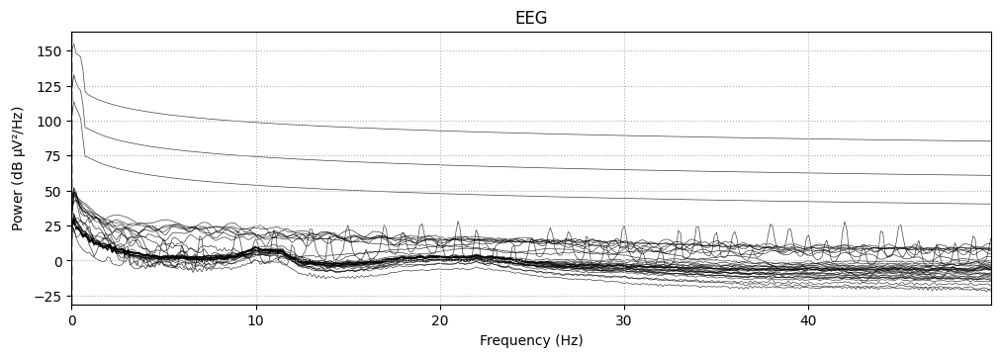

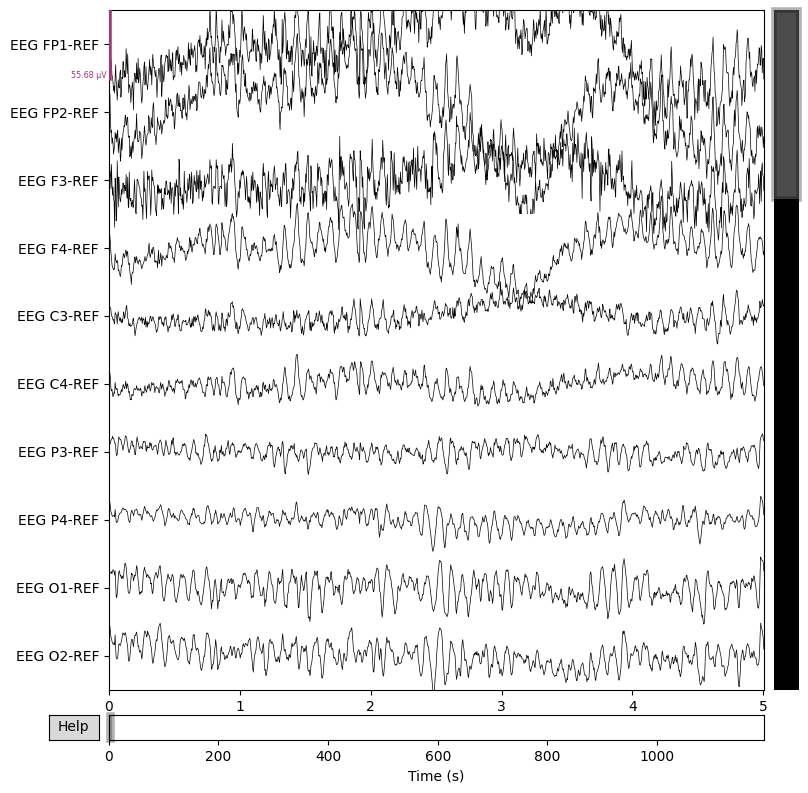

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaanzv_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 394749  =      0.000 ...  1578.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 30 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 30
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


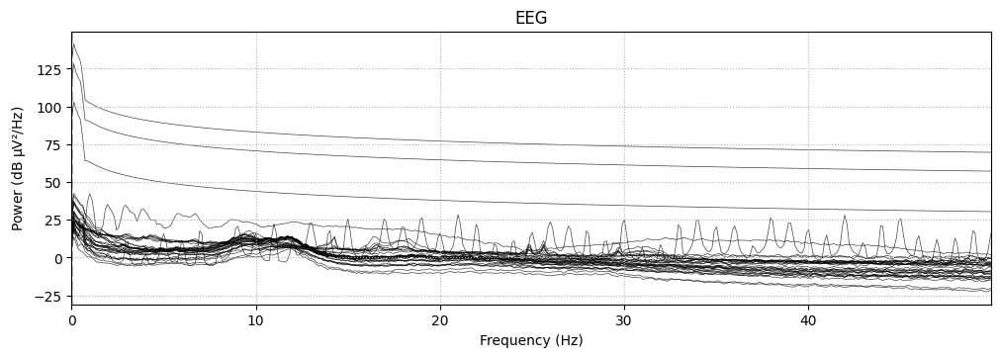

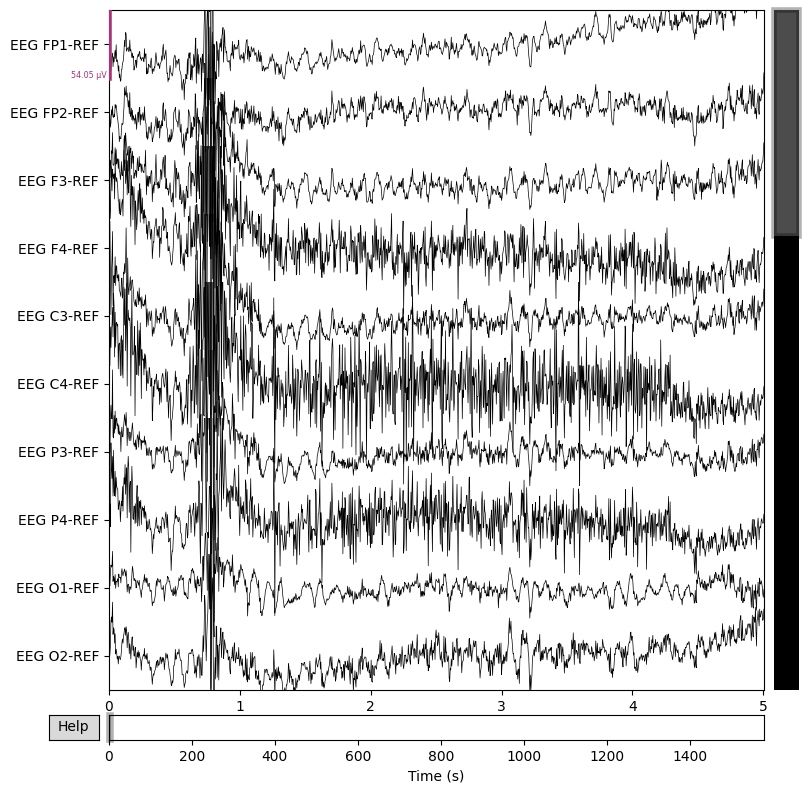

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaanip_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 301249  =      0.000 ...  1204.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 31 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2012-01-01 00:00:00 UTC
 nchan: 31
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


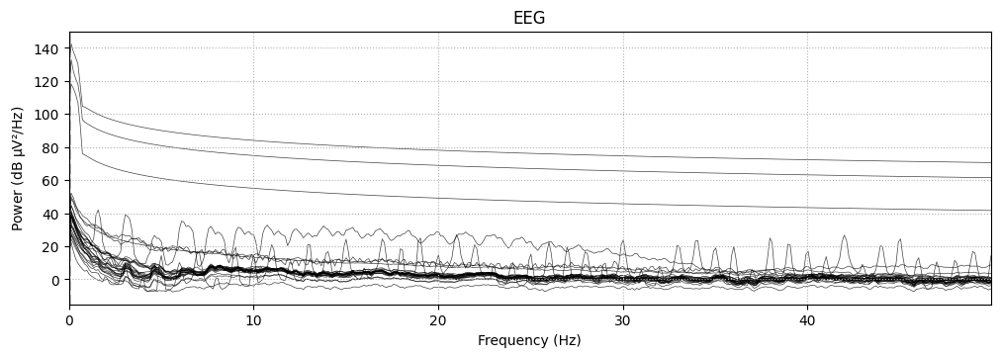

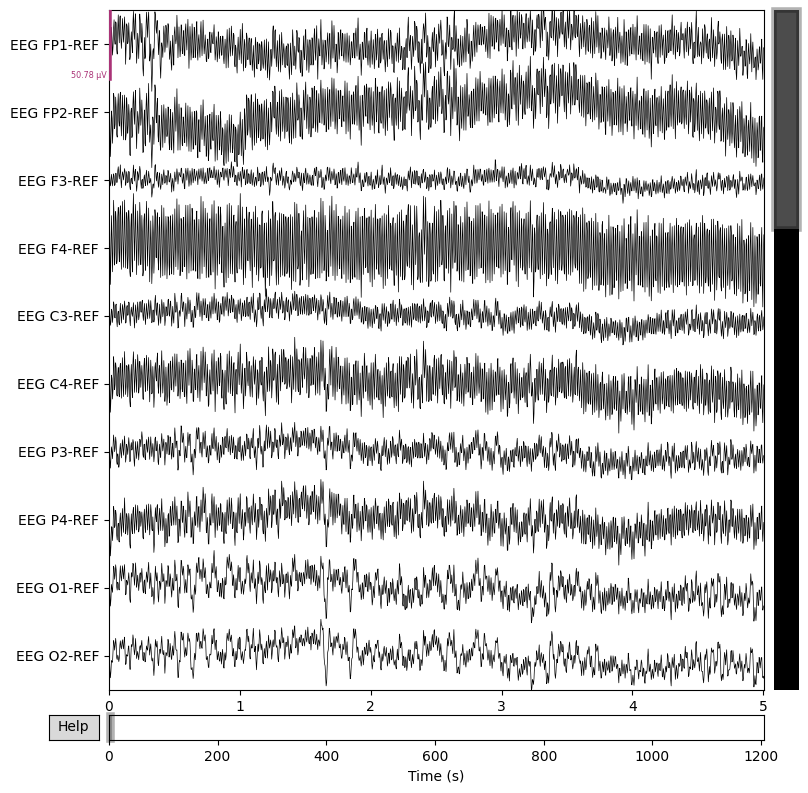

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaaotv_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:16: UserWarning: Zero value in spectrum for channel PHOTIC-REF
  psd = raw.compute_psd(fmax=50)
<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: UserWarning: Infinite value in PSD for channel PHOTIC-REF.
These channels might be dead.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 382499  =      0.000 ...  1529.996 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: EEG FP1-REF, EEG FP2-REF, EEG F3-REF, EEG F4-REF, EEG C3-REF, ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2013-01-01 00:00:00 UTC
 nchan: 36
 projs: []
 sfreq: 250.0 Hz
 subject_info: 3 items (dict)
>


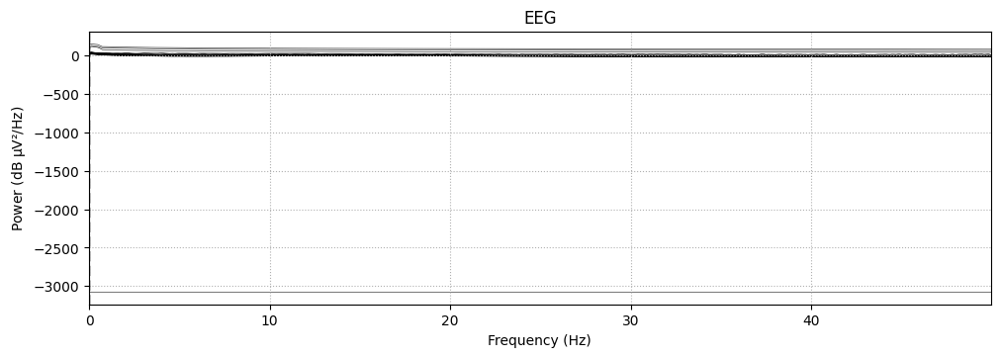

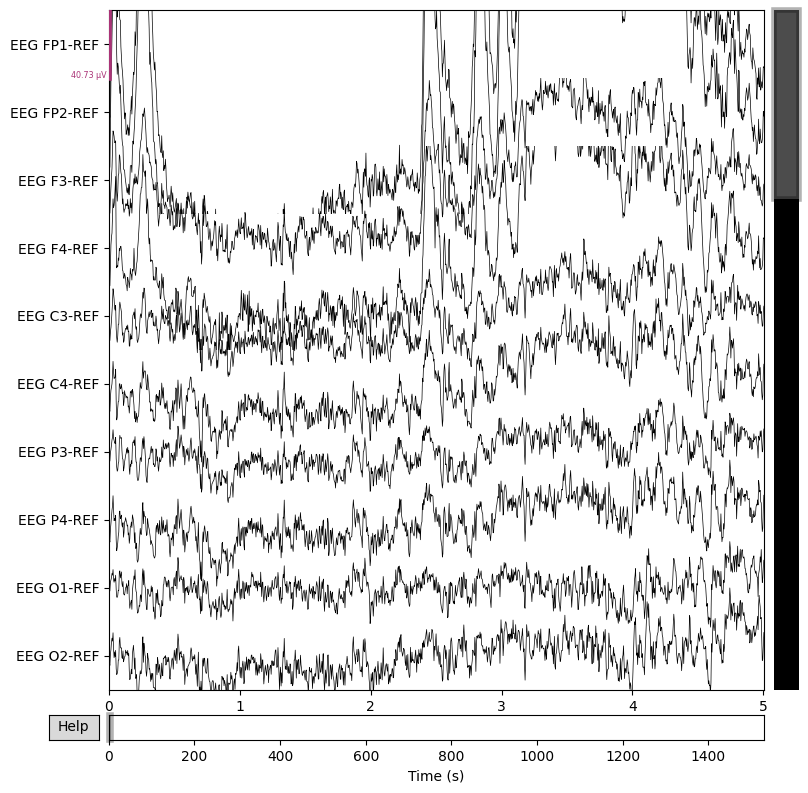

Effective window size : 8.192 (s)
Plotting power spectral density (dB=True).
Extracting EDF parameters from /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaapnk_s001_t000.edf...
EDF file detected


<ipython-input-6-f23c0ebc4a7d>:17: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  psd.plot()
<ipython-input-6-f23c0ebc4a7d>:17: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  psd.plot()


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 420999  =      0.000 ...  1683.996 secs...


KeyboardInterrupt: 

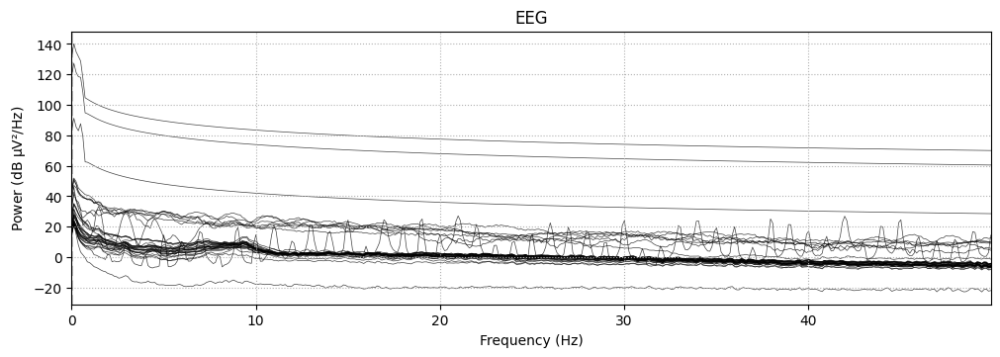

In [6]:
# Define the directory containing the EEG files
file_path = '/content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar'

# Function to read and plot EEG data
def read_eeg_file(file_path):
    # Read the EEG file
    raw = mne.io.read_raw(file_path, preload=True)

    # Print basic information about the EEG data
    print(raw.info)

    # Plot the raw EEG data
    raw.plot(n_channels=10, duration=5, scalings='auto')

    # Compute and plot power spectral density (PSD)
    psd = raw.compute_psd(fmax=50)
    psd.plot()

    # Return the raw data object for further analysis
    return raw

# Main function to execute the folder reading and processing
def main():
    if os.path.isdir(file_path):
        # List all files in the specified folder
        eeg_files = [f for f in os.listdir(file_path) if f.endswith(('.edf', '.fif'))]

        if eeg_files:
            for eeg_file in eeg_files:
                full_file_path = os.path.join(file_path, eeg_file)

                # Read and display the EEG file
                raw_data = read_eeg_file(full_file_path)
        else:
            print("No EEG files found in the specified folder")
    else:
        print("Specified path is not a directory")

# Execute the main function
if __name__ == "__main__":
    main()

Preprocessing cell

In [7]:
def butter_bandpass(lowcut, highcut, fs, order=4):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return b, a

def butter_highpass(cutoff, fs, order=4):
    nyquist = 0.5 * fs
    high = cutoff / nyquist
    b, a = butter(order, high, btype='high')
    return b, a

def butter_lowpass(cutoff, fs, order=4):
    nyquist = 0.5 * fs
    low = cutoff / nyquist
    b, a = butter(order, low, btype='low')
    return b, a

def notch_filter(data, fs, freq=60.0, quality_factor=30.0):
    nyquist = 0.5 * fs
    freq = freq / nyquist
    b, a = iirnotch(freq, quality_factor)
    y = lfilter(b, a, data)
    return y

def augment_signal(signal):
    noise = np.random.normal(0, 0.01, signal.shape)
    signal_shift = np.roll(signal, np.random.randint(-25, 25))
    signal_flip = signal[::-1]
    return signal + noise + signal_shift + signal_flip

def preprocess_signal(signal, fs=250):
    b, a = butter_highpass(1.0, fs, order=4)
    signal = lfilter(b, a, signal)
    signal = notch_filter(signal, fs, freq=60.0, quality_factor=30.0)
    signal = augment_signal(signal)
    return signal

def is_noisy(signal, lower_threshold=2, upper_threshold=250):
    std_dev = np.std(signal)
    is_noisy_signal = not (lower_threshold < std_dev < upper_threshold)
    print(f"Signal STD: {std_dev}, Is Noisy: {is_noisy_signal}")
    return is_noisy_signal


This was to visualize signals in amplitude-time graph

Files found: ['/content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaaoby_s001_t000.edf', '/content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaajdb_s001_t000.edf', '/content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaamzl_s001_t000.edf', '/content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaajvh_s001_t001.edf', '/content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaakqg_s001_t001.edf', '/content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaaiuo_s002_t000.edf', '/content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaakgp_s001_t001.edf', '/content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaaosw_s001_t000.edf', '/content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaapij_s001_t000.edf', '/content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaaowb_s001_t000.edf', '/content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaajna_s001_t000.ed

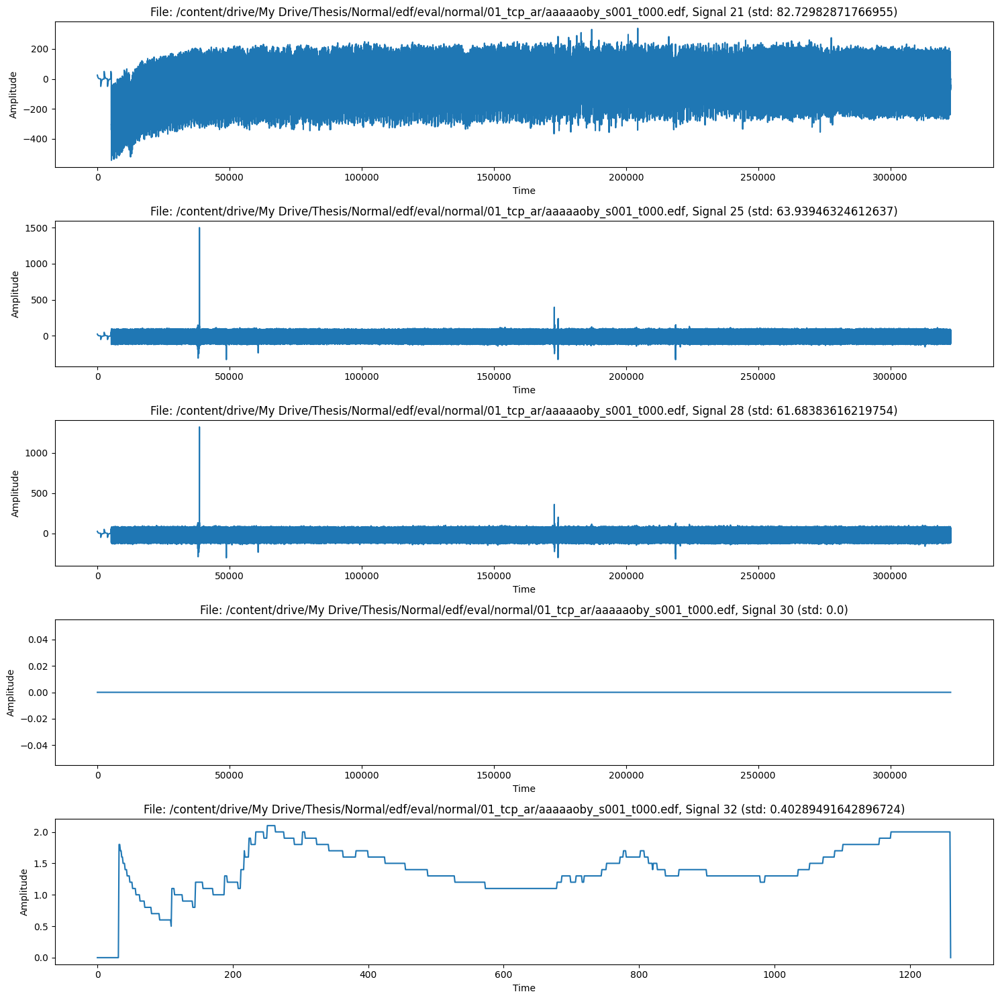

File: /content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaajdb_s001_t000.edf, Standard Deviations: [169.441370528099, 173.32196885431244, 163.45018646519557, 172.1098002217403, 163.09398345419424, 163.01574461318353, 162.93802562174739, 161.07613624760015, 164.01955932027164, 163.43293313321797, 166.70586106817464, 165.5659071093568, 163.02787652217208, 162.948129594586, 162.6135985103096, 162.43599162679536, 166.6352734528593, 162.9708191452356, 162.85351396477387, 160.9833754518035, 162.7001345666885, 162.97530981099467, 169.69936528175887, 186.79774558923538, 146.85301470850968, 165.61976821156495, 177.23468108580946, 162.15365781466352, 164.00183435149867, 168.09500017194793, 162.88089239206573, 162.9729502078169, 60.29790020413962, 12.795843537031455, 0.8779715372854736, 20.650985214150516]


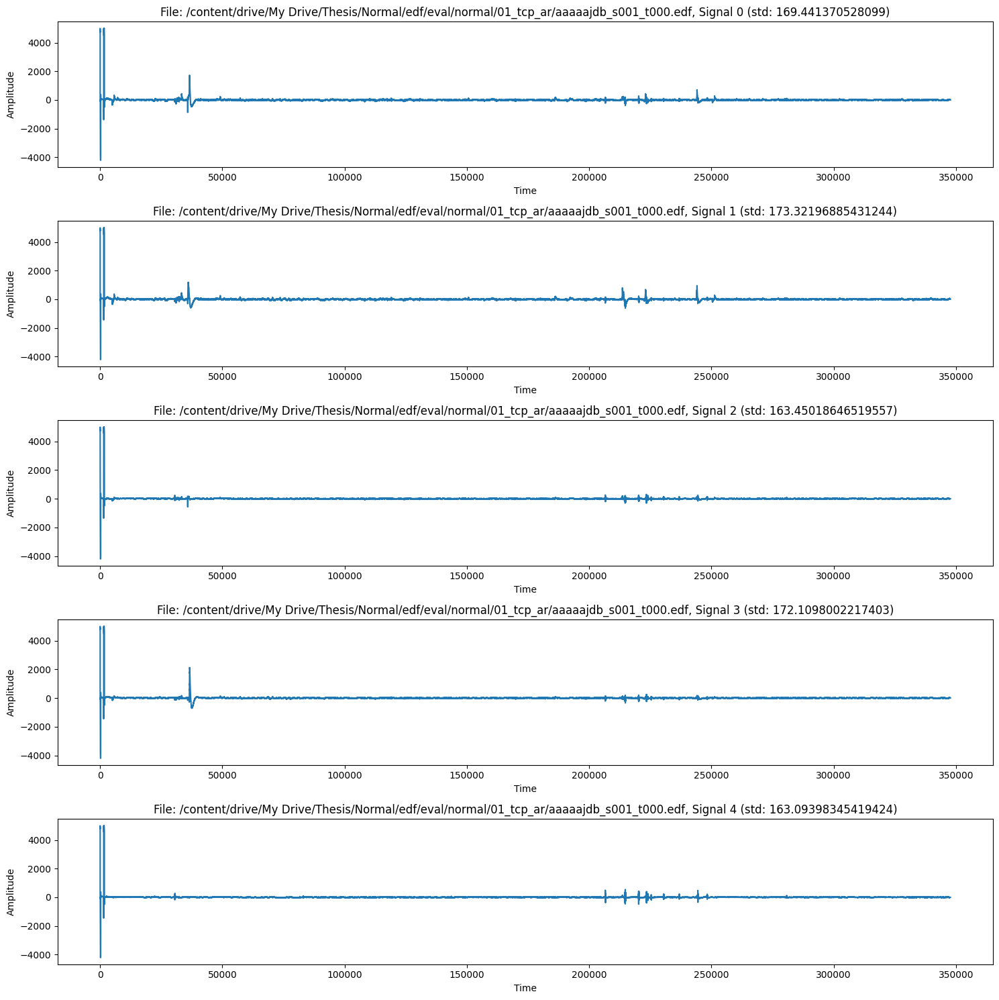

File: /content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaamzl_s001_t000.edf, Standard Deviations: [48.38644131869219, 35.69490290439502, 12.721679196016488, 16.054896687094942, 8.472297804271527, 13.328325375118574, 9.837330863665102, 12.840907546919235, 16.889155567429025, 18.432257983001023, 24.62019869619031, 20.637638900241903, 16.794256920702452, 17.851576356657947, 16.07278407524459, 18.06142673495644, 23.40229206314113, 22.005208546968852, 11.786482849822727, 8.262383006438421, 9.517450948284106, 43.2867784952385, 26.454376081855926, 136.33349180455733, 19.66172865069118, 20.11206645222112, 63.21861208461856, 0.0, 0.0, 0.0]


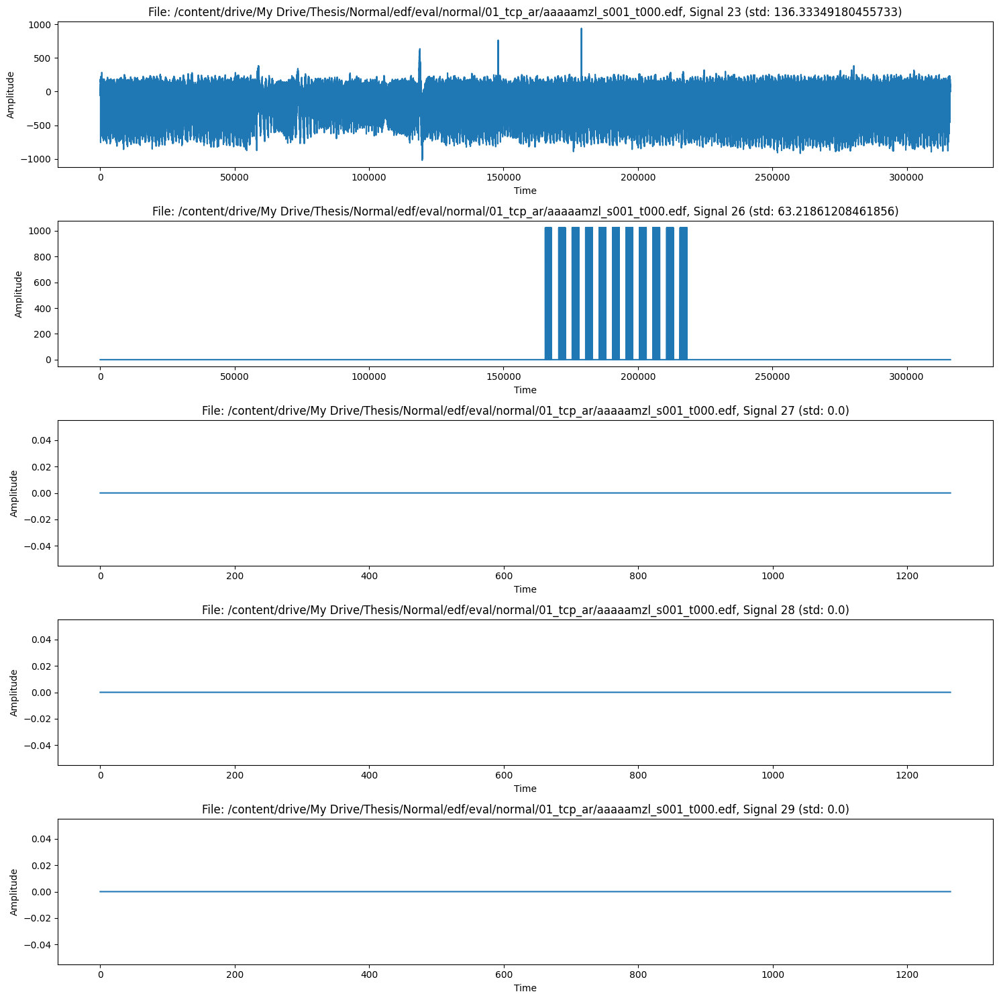

File: /content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaajvh_s001_t001.edf, Standard Deviations: [88.40160124014417, 84.79969425913349, 88.25981036918911, 142.50012845615504, 254.98141852432164, 89.2462809999497, 88.85782583267107, 85.53065736288424, 86.1152038425381, 88.56055349977952, 82.15805788233806, 90.12649199036424, 82.00070113499453, 158.98790671668672, 65.22644273306658, 86.55602392396105, 81.23559907629551, 91.68492281344997, 87.1488431393853, 89.35125358798477, 88.71566916353441, 93.91147129375348, 161.37904194532925, 114.53259758773179, 95.64822019410835, 104.27196601750225, 213.10623262862075, 76.2944809916299, 92.9174642875324, 65.82936558791009, 116.30719674469455, 87.88605291414379, 70.7510565982291, 0.0, 0.0, 0.0]


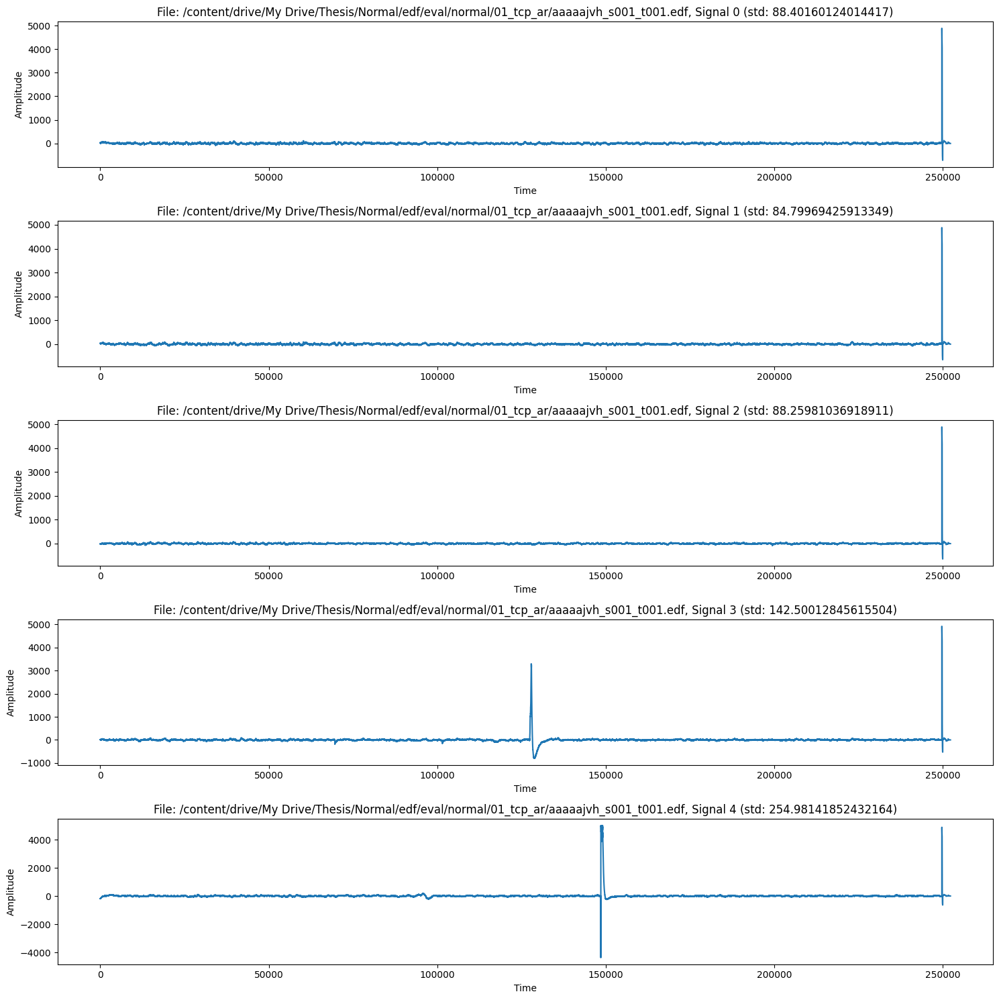

File: /content/drive/My Drive/Thesis/Normal/edf/eval/normal/01_tcp_ar/aaaaakqg_s001_t001.edf, Standard Deviations: [21.690660930555122, 23.42876921486188, 10.200407890569027, 11.22381627716778, 6.428368028123489, 5.767040394759389, 5.236261890229767, 4.984443859301186, 8.164267486958881, 6.765581672585215, 13.668831790400908, 11.97753111978579, 9.734778135103632, 9.201984203740503, 8.295476445224553, 7.784811148535826, 10.070829221016137, 10.204806924585831, 10.92466505217342, 15.450140345837744, 6.035688701825208, 20.533176555912053, 18.543087853963613, 107.50631775168085, 108.4272057542792, 178.1617767744271, 204.6892866495771, 111.74992649039181, 110.65920155557842, 150.53168836026413, 13.052277622684846, 12.291928495783356, 65.44690755456817, 83.16654287395433, 0.2845967124022004, 14.802857254841395]


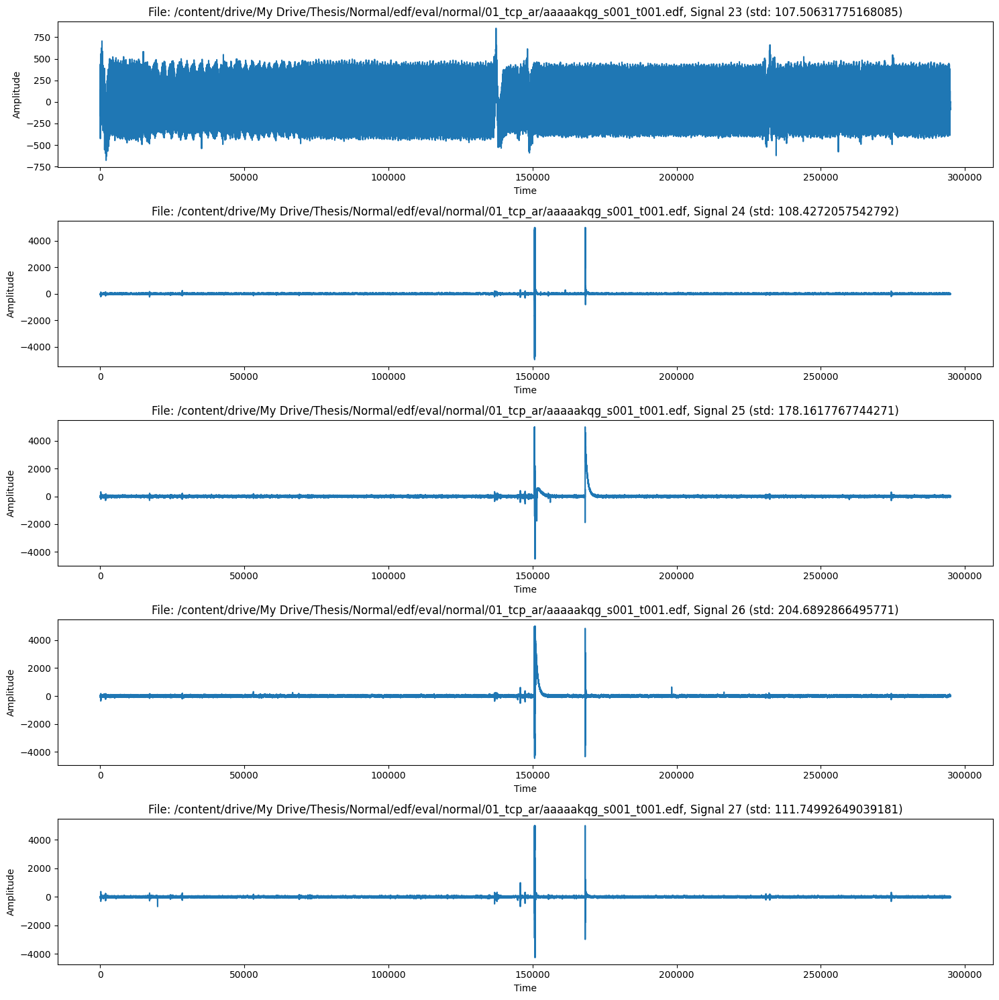

In [ ]:
def list_files_in_directory(directory_path):
    files_list = []
    for root, dirs, files in os.walk(directory_path):
        for file in files:
            if file.endswith('.edf'):  # Only add EDF files
                files_list.append(os.path.join(root, file))
    return files_list

#directory
base_path = "/content/drive/My Drive/Thesis/Normal/edf"
files_list = list_files_in_directory(base_path)
print(f"Files found: {files_list}")

def visualize_noisy_signals(file_paths, lower_threshold=2.0, upper_threshold=250, num_signals_to_plot=5):
    for file_path in file_paths:
        if os.path.exists(file_path):
            with pyedflib.EdfReader(file_path) as f:
                n = f.signals_in_file
                signals = [f.readSignal(i) for i in range(n)]
                std_devs = [np.std(signal) for signal in signals]
                print(f'File: {file_path}, Standard Deviations: {std_devs}')

                noisy_signals_indices = [i for i, std in enumerate(std_devs) if std < lower_threshold or std > upper_threshold]

                plt.figure(figsize=(15, num_signals_to_plot * 3))
                for i, signal_index in enumerate(noisy_signals_indices[:num_signals_to_plot]):
                    plt.subplot(num_signals_to_plot, 1, i + 1)
                    plt.plot(signals[signal_index])
                    plt.title(f'File: {file_path}, Signal {signal_index} (std: {std_devs[signal_index]})')
                    plt.xlabel('Time')
                    plt.ylabel('Amplitude')
                plt.tight_layout()
                plt.show()
        else:
            print(f"File not found: {file_path}")

# Visualize noisy signals from multiple files
visualize_noisy_signals(files_list[:5], lower_threshold=2.0, upper_threshold=60.0)


Adding preprocess data

In [ ]:
def preprocess_data(base_path, summary_df, target_length=15000, fs=250, num_channels=20, lower_threshold=2, upper_threshold=250):
    features = []
    labels = []
    noise_labels = {}
    processed_files = set()
    std_devs = []

    for index, row in summary_df.iterrows():
        file_path = row['File'].replace('_quality_report.csv', '.edf')
        if file_path in processed_files:
            continue

        try:
            if os.path.exists(file_path):
                print(f"Processing file: {file_path}")
                with pyedflib.EdfReader(file_path) as f:
                    n = min(f.signals_in_file, num_channels)
                    all_signals = []
                    noisy = False
                    for i in range(n):
                        signal = f.readSignal(i)
                        signal = preprocess_signal(signal, fs=fs)
                        std_devs.append(np.std(signal))
                        if is_noisy(signal, lower_threshold, upper_threshold):
                            noisy = True
                            print(f"Noisy signal detected in file: {file_path}")
                            break
                        if len(signal) > target_length:
                            signal = signal[:target_length]
                        elif len(signal) < target_length:
                            signal = np.pad(signal, (0, target_length - len(signal)), 'constant')
                        all_signals.append(signal)
                    if not noisy:
                        all_signals = np.array(all_signals)
                        if all_signals.shape[0] < num_channels:
                            padding = np.zeros((num_channels - all_signals.shape[0], target_length))
                            all_signals = np.vstack((all_signals, padding))
                        features.append(all_signals)
                        if 'abnormal' in file_path:
                            label = 0
                            print(f"Labeling file {file_path} as Abnormal (0)")
                        else:
                            label = 1
                            print(f"Labeling file {file_path} as Normal (1)")
                        labels.append(label)
                        noise_labels[file_path] = 'not noisy'
                    else:
                        noise_labels[file_path] = 'noisy'
        except Exception as e:
            print(f"Error processing file {file_path}: {e}")

        processed_files.add(file_path)

    if features:
        X = np.array(features)
        y = np.array(labels)
        return X, y, noise_labels, std_devs
    else:
        raise ValueError("No features were extracted. Please check the file paths and feature extraction process.")


Define the EEGDataset class with Data Augmentation

In [ ]:

class EEGDataset(Dataset):
    def __init__(self, features, labels, augment=False):
        self.features = features
        self.labels = labels
        self.augment = augment

    def __len__(self):
        return len(self.features)

    def __getitem__(self, idx):
        x = self.features[idx]
        y = self.labels[idx]
        if self.augment:
            x = augment_signal(x)
        return torch.tensor(x, dtype=torch.float32), torch.tensor(y, dtype=torch.long)

# Load Summary CSV
base_path = "/content/drive/My Drive/Thesis/Normal/edf"
summary_csv_path = os.path.join(base_path, 'summary_quality_report.csv')
summary_df = pd.read_csv(summary_csv_path)

# Preprocess Data with debug prints
features, labels, noise_labels, std_devs = preprocess_data(base_path, summary_df)

# Count labels before resampling
initial_label_counts = Counter(labels)
print(f"Initial label counts: {initial_label_counts}")

# Normalize the features
scaler = StandardScaler()
normalized_features = scaler.fit_transform(features.reshape(features.shape[0], -1)).reshape(features.shape)

# Create dataset
dataset = EEGDataset(normalized_features, labels, augment=True)

# Split the dataset
train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size

assert train_size + val_size + test_size == len(dataset)

train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])

# Create dataloaders
batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

dataloaders = {'train': train_loader, 'val': val_loader, 'test': test_loader}

print(dataloaders.keys())

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
Labeling file /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaanmw_s001_t000.edf as Normal (1)
Processing file: /content/drive/My Drive/Thesis/Normal/edf/train/normal/01_tcp_ar/aaaaajvj_s001_t000.edf
Signal STD: 155.1264736051915, Is Noisy: False
Signal STD: 115.12176655639804, Is Noisy: False
Signal STD: 145.7245296539943, Is Noisy: False
Signal STD: 135.76260484688586, Is Noisy: False
Signal STD: 124.3944273481131, Is Noisy: False
Signal STD: 146.8545758097381, Is Noisy: False
Signal STD: 124.76358142409194, Is Noisy: False
Signal STD: 140.10690082702018, Is Noisy: False
Signal STD: 131.0610702928834, Is Noisy: False
Signal STD: 124.53372230973264, Is Noisy: False
Signal STD: 123.07906063424821, Is Noisy: False
Signal STD: 121.77634186133456, Is Noisy: False
Signal STD: 158.70282403486058, Is Noisy: False
Signal STD: 155.79549863194342, Is Noisy: False
Signal STD: 107.47254036061734, Is Noisy: False
Signal STD: 145.149446545362

Visualize the Standard deviation of 5%

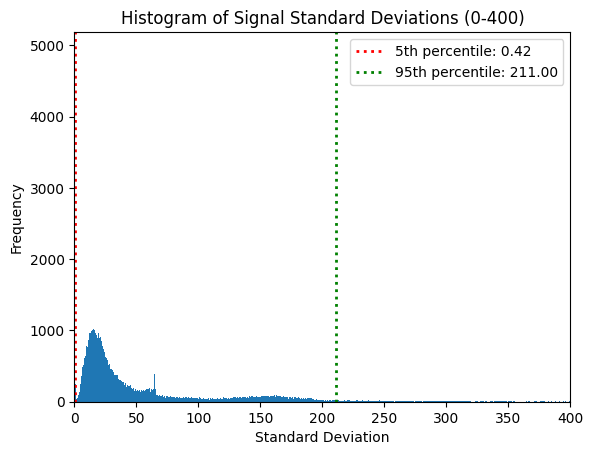

In [ ]:
# Analyze standard deviations
std_devs = []
for root, _, files in os.walk(base_path):
    for file in files:
        if file.endswith('.edf'):
            file_path = os.path.join(root, file)
            if os.path.exists(file_path):
                with pyedflib.EdfReader(file_path) as f:
                    n = f.signals_in_file
                    signals = [f.readSignal(i) for i in range(n)]
                    std_devs.extend([np.std(signal) for signal in signals])

# Calculate percentiles
lower_percentile = np.percentile(std_devs, 5)
upper_percentile = np.percentile(std_devs, 95)

# Plot histogram
plt.hist(std_devs, bins=1000, range=(0, 400))
plt.title('Histogram of Signal Standard Deviations (0-400)')
plt.xlabel('Standard Deviation')
plt.ylabel('Frequency')
plt.xlim(0, 400)

# Add vertical lines at the 5th and 95th percentiles
plt.axvline(lower_percentile, color='r', linestyle='dotted', linewidth=2, label=f'5th percentile: {lower_percentile:.2f}')
plt.axvline(upper_percentile, color='g', linestyle='dotted', linewidth=2, label=f'95th percentile: {upper_percentile:.2f}')

# Add legend
plt.legend()

# Show plot
plt.show()

Prevent overfitting due to imbalance dataset

In [ ]:
from imblearn.over_sampling import SMOTE

def balance_dataset(features, labels):
    smote = SMOTE()
    features_resampled, labels_resampled = smote.fit_resample(features.reshape(len(features), -1), labels)
    features_resampled = features_resampled.reshape(len(features_resampled), features.shape[1], features.shape[2])
    return features_resampled, labels_resampled

# Balance the dataset
features_resampled, labels_resampled = balance_dataset(features, labels)

# Create dataset with balanced data
dataset = EEGDataset(features_resampled, labels_resampled)

Dataloader for training

In [ ]:
class BasicBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super(BasicBlock, self).__init__()
        self.conv1 = nn.Conv1d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1)
        self.bn1 = nn.BatchNorm1d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv1d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm1d(out_channels)
        self.downsample = nn.Sequential()
        if stride != 1 or in_channels != out_channels:
            self.downsample = nn.Sequential(
                nn.Conv1d(in_channels, out_channels, kernel_size=1, stride=stride),
                nn.BatchNorm1d(out_channels)
            )

    def forward(self, x):
        residual = self.downsample(x)
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)
        out += residual
        out = self.relu(out)
        return out

class ResNet1D(nn.Module):
    def __init__(self, block, layers, num_classes=2):
        super(ResNet1D, self).__init__()
        self.in_channels = 64
        self.conv = nn.Conv1d(20, 64, kernel_size=7, stride=2, padding=3)
        self.bn = nn.BatchNorm1d(64)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool1d(kernel_size=3, stride=2, padding=1)
        self.layer1 = self._make_layer(block, 64, layers[0])
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 512, layers[3], stride=2)
        self.avgpool = nn.AdaptiveAvgPool1d(1)
        self.fc = nn.Linear(512, num_classes)
        self.dropout = nn.Dropout(0.5)

    def _make_layer(self, block, out_channels, blocks, stride=1):
        layers = []
        layers.append(block(self.in_channels, out_channels, stride))
        self.in_channels = out_channels
        for _ in range(1, blocks):
            layers.append(block(out_channels, out_channels))
        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        x = self.relu(x)
        x = self.maxpool(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.avgpool(x)
        x = x.view(x.size(0), -1)
        x = self.dropout(x)
        x = self.fc(x)
        return x

def resnet18_1d(num_classes=2):
    return ResNet1D(BasicBlock, [2, 2, 2, 2], num_classes)

class TransformerEncoderLayer(nn.Module):
    def __init__(self, embed_dim, num_heads, ff_dim, dropout=0.5):
        super(TransformerEncoderLayer, self).__init__()
        self.self_attention = SelfAttention(embed_dim, num_heads)
        self.norm1 = nn.LayerNorm(embed_dim)
        self.ff = nn.Sequential(
            nn.Linear(embed_dim, ff_dim),
            nn.ReLU(),
            nn.Linear(ff_dim, embed_dim)
        )
        self.norm2 = nn.LayerNorm(embed_dim)
        self.dropout = nn.Dropout(dropout)

    def forward(self, x):
        attn_output = self.self_attention(x)
        x = x + self.dropout(attn_output)
        x = self.norm1(x)
        ff_output = self.ff(x)
        x = x + self.dropout(ff_output)
        x = self.norm2(x)
        return x

class SelfAttention(nn.Module):
    def __init__(self, embed_dim, num_heads):
        super(SelfAttention, self).__init__()
        self.embed_dim = embed_dim
        self.num_heads = num_heads
        self.head_dim = embed_dim // num_heads

        assert self.head_dim * num_heads == embed_dim, "embed_dim must be divisible by num_heads"

        self.query = nn.Linear(embed_dim, embed_dim)
        self.key = nn.Linear(embed_dim, embed_dim)
        self.value = nn.Linear(embed_dim, embed_dim)
        self.out = nn.Linear(embed_dim, embed_dim)

    def forward(self, x):
        batch_size, seq_length, embed_dim = x.size()

        Q = self.query(x)
        K = self.key(x)
        V = self.value(x)

        Q = Q.view(batch_size, seq_length, self.num_heads, self.head_dim).transpose(1, 2)
        K = K.view(batch_size, seq_length, self.num_heads, self.head_dim).transpose(1, 2)
        V = V.view(batch_size, seq_length, self.num_heads, self.head_dim).transpose(1, 2)

        scores = torch.matmul(Q, K.transpose(-2, -1)) / self.head_dim ** 0.5
        attn_weights = F.softmax(scores, dim=-1)
        attn_output = torch.matmul(attn_weights, V)

        attn_output = attn_output.transpose(1, 2).contiguous().view(batch_size, seq_length, embed_dim)
        output = self.out(attn_output)

        return output


Function to evaluate the model and return the validation loss and accuracy

In [ ]:
from sklearn.model_selection import StratifiedKFold
from torch.utils.tensorboard import SummaryWriter

def evaluate_model(model, dataloader):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    model.eval()

    all_preds = []
    all_labels = []
    running_loss = 0.0

    with torch.no_grad():
        for inputs, labels in dataloader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = F.cross_entropy(outputs, labels)

            running_loss += loss.item() * inputs.size(0)
            all_preds.append(preds.cpu().numpy())
            all_labels.append(labels.cpu().numpy())

    all_preds = np.concatenate(all_preds)
    all_labels = np.concatenate(all_labels)

    accuracy = np.mean(all_preds == all_labels)
    avg_loss = running_loss / len(dataloader.dataset)

    print(f'Validation Loss: {avg_loss:.4f} Acc: {accuracy:.4f}')
    print('Confusion Matrix:\n', confusion_matrix(all_labels, all_preds))
    print('Classification Report:\n', classification_report(all_labels, all_preds))

    return avg_loss, accuracy

# Function to train and evaluate using cross-validation
def cross_val_train_evaluate(model_class, dataset, num_folds=5, num_epochs=50, batch_size=16, log_dir='./logs', patience=10):
    skf = StratifiedKFold(n_splits=num_folds)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    features, labels = dataset.features, dataset.labels
    all_val_losses = []
    all_val_accuracies = []

    for fold, (train_idx, val_idx) in enumerate(skf.split(features, labels)):
        print(f"Fold {fold+1}/{num_folds}")

        train_features, val_features = features[train_idx], features[val_idx]
        train_labels, val_labels = labels[train_idx], labels[val_idx]

        train_dataset = EEGDataset(train_features, train_labels)
        val_dataset = EEGDataset(val_features, val_labels)

        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
        dataloaders = {'train': train_loader, 'val': val_loader}

        model = model_class().to(device)

        criterion = FocalLoss(alpha=1, gamma=2)
        optimizer = Adam(model.parameters(), lr=1e-4, weight_decay=1e-4)

        # Training function with TensorBoard logging
        def train_model(model, dataloaders, criterion, optimizer, num_epochs=50, log_dir='./logs', patience=10):
            best_model_wts = copy.deepcopy(model.state_dict())
            best_loss = float('inf')
            epochs_no_improve = 0

            writer = SummaryWriter(log_dir=f"{log_dir}/fold_{fold+1}")

            scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5)

            for epoch in range(num_epochs):
                print(f'Epoch {epoch}/{num_epochs - 1}')
                print('-' * 10)

                for phase in ['train', 'val']:
                    if phase == 'train':
                        model.train()
                    else:
                        model.eval()

                    running_loss = 0.0
                    running_corrects = 0

                    for inputs, labels in dataloaders[phase]:
                        inputs = inputs.to(device)
                        labels = labels.to(device)

                        with torch.set_grad_enabled(phase == 'train'):
                            outputs = model(inputs)
                            _, preds = torch.max(outputs, 1)
                            loss = criterion(outputs, labels)

                            if phase == 'train':
                                loss.backward()
                                nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
                                optimizer.step()
                                optimizer.zero_grad()

                        running_loss += loss.item() * inputs.size(0)
                        running_corrects += torch.sum(preds == labels.data)

                    epoch_loss = running_loss / len(dataloaders[phase].dataset)
                    epoch_acc = running_corrects.double() / len(dataloaders[phase].dataset)

                    print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

                    writer.add_scalar(f'{phase} Loss', epoch_loss, epoch)
                    writer.add_scalar(f'{phase} Acc', epoch_acc, epoch)

                    if phase == 'val':
                        scheduler.step(epoch_loss)

                        if epoch_loss < best_loss:
                            best_loss = epoch_loss
                            best_model_wts = copy.deepcopy(model.state_dict())
                            epochs_no_improve = 0
                        else:
                            epochs_no_improve += 1

                if epochs_no_improve >= patience:
                    print("Early stopping")
                    break

            writer.close()
            print('Best val Loss: {:4f}'.format(best_loss))
            model.load_state_dict(best_model_wts)
            return model

        model = train_model(model, dataloaders, criterion, optimizer, num_epochs=num_epochs, log_dir=log_dir, patience=patience)

        val_loss, val_acc = evaluate_model(model, val_loader)
        all_val_losses.append(val_loss)
        all_val_accuracies.append(val_acc)

    avg_val_loss = np.mean(all_val_losses)
    avg_val_acc = np.mean(all_val_accuracies)
    print(f"Average Validation Loss: {avg_val_loss:.4f}")
    print(f"Average Validation Accuracy: {avg_val_acc:.4f}")

    return avg_val_loss, avg_val_acc

# Define ResNet model
model_class = resnet18_1d

# Perform cross-validation training and evaluation
cross_val_train_evaluate(model_class, dataset, num_folds=5, num_epochs=50, batch_size=16, log_dir='./logs', patience=10)


Fold 1/5
Epoch 0/49
----------
train Loss: 0.1752 Acc: 0.6466
val Loss: 0.1377 Acc: 0.7234
Epoch 1/49
----------
train Loss: 0.1435 Acc: 0.7377
val Loss: 0.1031 Acc: 0.8213
Epoch 2/49
----------
train Loss: 0.1317 Acc: 0.7571
val Loss: 0.1085 Acc: 0.8110
Epoch 3/49
----------
train Loss: 0.1270 Acc: 0.7709
val Loss: 0.1033 Acc: 0.8230
Epoch 4/49
----------
train Loss: 0.1180 Acc: 0.7842
val Loss: 0.1005 Acc: 0.8213
Epoch 5/49
----------
train Loss: 0.1236 Acc: 0.7885
val Loss: 0.1018 Acc: 0.8282
Epoch 6/49
----------
train Loss: 0.1104 Acc: 0.8151
val Loss: 0.1302 Acc: 0.7973
Epoch 7/49
----------
train Loss: 0.1143 Acc: 0.8078
val Loss: 0.1353 Acc: 0.7766
Epoch 8/49
----------
train Loss: 0.1075 Acc: 0.8212
val Loss: 0.1146 Acc: 0.8110
Epoch 9/49
----------
train Loss: 0.1049 Acc: 0.8250
val Loss: 0.1537 Acc: 0.7595
Epoch 10/49
----------
train Loss: 0.1009 Acc: 0.8418
val Loss: 0.1692 Acc: 0.7766
Epoch 11/49
----------
train Loss: 0.0924 Acc: 0.8448
val Loss: 0.2227 Acc: 0.7595
Epoch

(0.49151495647929905, 0.7954007487978423)

To run tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir ./logs


<IPython.core.display.Javascript object>